In [26]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
plt.style.use("bmh")
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg')
from datetime import datetime, timedelta, date, time
import seaborn as sns
import matplotlib.dates as mdates
import operator
import ssl
import urllib
import json
from haversine import haversine, Unit
import folium


---

In [28]:
sns.set_theme()

# Import the Data

Trip data (already formatted and outliers have been removed, please refer to Preprocessing.ipynb)

In [30]:
df_bonn = pd.read_pickle("data/df_bonn.pickle")
df_essen = pd.read_pickle("data/df_essen.pickle")

In [32]:
# Create a weekday dictonary to show the weekday names in the plots
weekdays = {
    0: "Monday",
    1: "Tuesday",
    2: "Wednesday",
    3: "Thursday",
    4: "Friday",
    5: "Saturday",
    6: "Sunday"
}

In [34]:
# Create a season dictonary to show the season names in the plots
seasons = {
    0: "Winter",
    1: "Spring",
    2: "Summer",
    3: "Autumn",
}

## Import API Data

In [36]:
context = ssl._create_unverified_context()

def request(city_id):
    response = urllib.request.urlopen(f"https://api.nextbike.net/maps/nextbike-live.json?city={city_id}", context=context)
    response = response.read().decode("utf-8")
    return json.loads(response)

bonn_json = request(547)["countries"][0]["cities"][0] # Bonn city ID at NextBike is 547
essen_json = request(133)["countries"][0]["cities"][0] # Essen city ID at NextBike ist 133

In [38]:
# Use as center points for maps:
bonn_center = np.array([bonn_json["lat"], bonn_json["lng"]])
essen_center = np.array([essen_json["lat"], essen_json["lng"]])

## Weather Data

In [40]:
# Import weather data
df_weather_bonn = pd.read_pickle("data/df_weather_bonn.pickle")
df_weather_essen = pd.read_pickle("data/df_weather_essen.pickle")

---

 # KPIs

## 1: Number of trips

Devide the dataframes into seasons

In [42]:
df_bonn_winter = df_bonn.loc[df_bonn['season'] == 0]
df_bonn_spring = df_bonn.loc[df_bonn['season'] == 1]
df_bonn_summer = df_bonn.loc[df_bonn['season'] == 2]

df_essen_winter = df_essen.loc[df_essen['season'] == 0]
df_essen_spring = df_essen.loc[df_essen['season'] == 1]
df_essen_summer = df_essen.loc[df_essen['season'] == 2]

In [44]:
df_bonn_winter.head()

,day,time,b_number,city,trip_duration,timestamp,weekday,hour,season,orig,dest
0,2019-02-01,00:03:00,44894,Bonn,0 days 00:07:00,2019-02-01 00:03:00,4,0,0,"[50.7366, 7.1009]","[50.739, 7.093]"
1,2019-02-01,00:12:00,44973,Bonn,0 days 00:20:00,2019-02-01 00:12:00,4,0,0,"[50.7364, 7.0927]","[50.732, 7.1004]"
2,2019-02-01,00:37:00,44802,Bonn,0 days 00:06:00,2019-02-01 00:37:00,4,0,0,"[50.7372, 7.0911]","[50.7336, 7.095]"
3,2019-02-01,00:38:00,44717,Bonn,0 days 00:07:00,2019-02-01 00:38:00,4,0,0,"[50.7476, 7.0826]","[50.7543, 7.0715]"
4,2019-02-01,00:44:00,44639,Bonn,0 days 00:10:00,2019-02-01 00:44:00,4,0,0,"[50.7392, 7.0906]","[50.7525, 7.0712]"


The first KPI investigates the total number of trips in Bonn and Essen.
Since each row of our proprecessed dataframes represents a single trip, we can just count them:

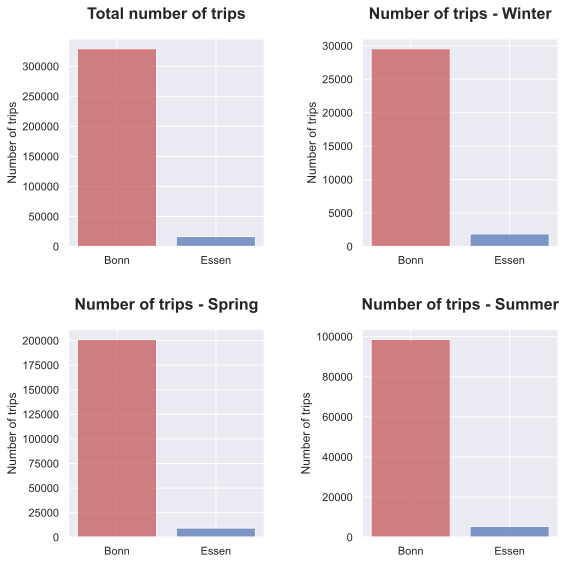

In [46]:
cities = ("Bonn", "Essen")

## Savings trip counts
# Total
trips_count_bonn = df_bonn.shape[0]
trips_count_essen = df_essen.shape[0]
trips_count_combined = (trips_count_bonn, trips_count_essen)

# Winter
trips_count_bonn_winter = df_bonn_winter.shape[0]
trips_count_essen_winter = df_essen_winter.shape[0]
trips_count_combined_winter = (trips_count_bonn_winter, trips_count_essen_winter)

# Spring
trips_count_bonn_spring = df_bonn_spring.shape[0]
trips_count_essen_spring = df_essen_spring.shape[0]
trips_count_combined_spring = (trips_count_bonn_spring, trips_count_essen_spring)

# Summer
trips_count_bonn_summer = df_bonn_summer.shape[0]
trips_count_essen_summer = df_essen_summer.shape[0]
trips_count_combined_summer = (trips_count_bonn_summer, trips_count_essen_summer)

# Plot results
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2,2,figsize=(8,8))

# Total
ax1.bar(cities, trips_count_combined, color=['C3','C0'], alpha=0.7)
ax1.set_ylabel("Number of trips")
ax1.set_title("Total number of trips", fontsize=16, fontweight="bold", pad=20)

# Winter
ax2.bar(cities, trips_count_combined_winter, color=['C3','C0'], alpha=0.7)
ax2.set_ylabel("Number of trips")
ax2.set_title("Number of trips - Winter", fontsize=16, fontweight="bold", pad=20)

# Spring
ax3.bar(cities, trips_count_combined_spring, color=['C3','C0'], alpha=0.7)
ax3.set_ylabel("Number of trips")
ax3.set_title("Number of trips - Spring", fontsize=16, fontweight="bold", pad=20)

# Summer
ax4.bar(cities, trips_count_combined_summer, color=['C3','C0'], alpha=0.7)
ax4.set_ylabel("Number of trips")
ax4.set_title("Number of trips - Summer", fontsize=16, fontweight="bold", pad=20)

fig.tight_layout()
fig.subplots_adjust(wspace=0.5, hspace=0.4)

As displayed in the graphs above, there is a huge gap in number of trips. This fact alone can not be seen as an indicator of nextbike's performance in the chosen cities. Furthermore, the combination of total trip numbers and city's numbers of bikes gives us an hint about the difference in performance of nextbike fleets.

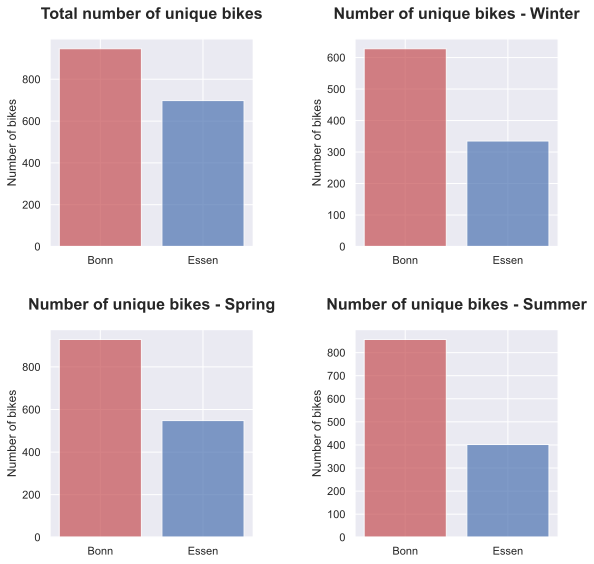

In [48]:
# Counting number of unique bikes per season
# Total
fleet_size_bonn = df_bonn["b_number"].nunique()
fleet_size_essen = df_essen["b_number"].nunique()
fleet_sizes_combined = (fleet_size_bonn, fleet_size_essen)

# Winter
fleet_size_bonn_winter = df_bonn_winter["b_number"].nunique()
fleet_size_essen_winter = df_essen_winter["b_number"].nunique()
fleet_sizes_combined_winter = (fleet_size_bonn_winter, fleet_size_essen_winter)

# Spring
fleet_size_bonn_spring = df_bonn_spring["b_number"].nunique()
fleet_size_essen_spring = df_essen_spring["b_number"].nunique()
fleet_sizes_combined_spring = (fleet_size_bonn_spring, fleet_size_essen_spring)

# Summer
fleet_size_bonn_summer = df_bonn_summer["b_number"].nunique()
fleet_size_essen_summer = df_essen_summer["b_number"].nunique()
fleet_sizes_combined_summer = (fleet_size_bonn_summer, fleet_size_essen_summer)

# Plot results
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2,2,figsize=(8,8))

# Total
ax1.bar(cities, fleet_sizes_combined, color=['C3','C0'], alpha=0.7)
ax1.set_ylabel("Number of bikes")
ax1.set_title("Total number of unique bikes", fontsize=16, fontweight="bold", pad=20)

# Winter
ax2.bar(cities, fleet_sizes_combined_winter, color=['C3','C0'], alpha=0.7)
ax2.set_ylabel("Number of bikes")
ax2.set_title("Number of unique bikes - Winter", fontsize=16, fontweight="bold", pad=20)

# Spring
ax3.bar(cities, fleet_sizes_combined_spring, color=['C3','C0'], alpha=0.7)
ax3.set_ylabel("Number of bikes")
ax3.set_title("Number of unique bikes - Spring", fontsize=16, fontweight="bold", pad=20)

# Summer
ax4.bar(cities, fleet_sizes_combined_summer, color=['C3','C0'], alpha=0.7)
ax4.set_ylabel("Number of bikes")
ax4.set_title("Number of unique bikes - Summer", fontsize=16, fontweight="bold", pad=20)

fig.tight_layout()
fig.subplots_adjust(wspace=0.5, hspace=0.4)

The graphs above show, that Bonn's fleet size is bigger than Essen's fleet size by 247 bikes. Now trip and bike count of each city gets put in proportion with each other.

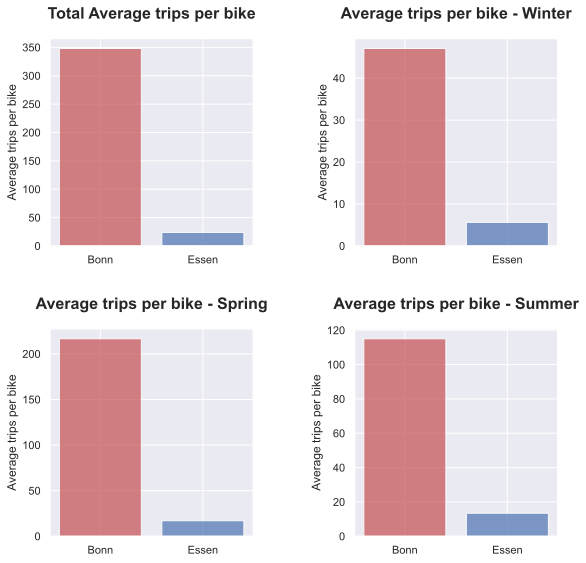

In [50]:
# Putting trips and unique bikes count in proportion
# Total
trips_per_bike_bonn = trips_count_bonn / fleet_size_bonn
trips_per_bike_essen = trips_count_essen / fleet_size_essen
avg_trips_combined = (trips_per_bike_bonn, trips_per_bike_essen)

# Winter
trips_per_bike_bonn_winter = trips_count_bonn_winter / fleet_size_bonn_winter
trips_per_bike_essen_winter = trips_count_essen_winter / fleet_size_essen_winter
avg_trips_combined_winter = (trips_per_bike_bonn_winter, trips_per_bike_essen_winter)

# Spring
trips_per_bike_bonn_spring = trips_count_bonn_spring / fleet_size_bonn_spring
trips_per_bike_essen_spring = trips_count_essen_spring / fleet_size_essen_spring
avg_trips_combined_spring = (trips_per_bike_bonn_spring, trips_per_bike_essen_spring)

# Summer
trips_per_bike_bonn_summer = trips_count_bonn_summer / fleet_size_bonn_summer
trips_per_bike_essen_summer = trips_count_essen_summer / fleet_size_essen_summer
avg_trips_combined_summer= (trips_per_bike_bonn_summer, trips_per_bike_essen_summer)

# Plot results
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2,2,figsize=(8,8))

# Total
ax1.bar(cities, avg_trips_combined, color=['C3','C0'], alpha=0.7)
ax1.set_ylabel("Average trips per bike")
ax1.set_title("Total Average trips per bike", fontsize=16, fontweight="bold", pad=20)

# Winter
ax2.bar(cities, avg_trips_combined_winter, color=['C3','C0'], alpha=0.7)
ax2.set_ylabel("Average trips per bike")
ax2.set_title("Average trips per bike - Winter", fontsize=16, fontweight="bold", pad=20)

# Spring
ax3.bar(cities, avg_trips_combined_spring, color=['C3','C0'], alpha=0.7)
ax3.set_ylabel("Average trips per bike")
ax3.set_title("Average trips per bike - Spring", fontsize=16, fontweight="bold", pad=20)

# Summer
ax4.bar(cities, avg_trips_combined_summer, color=['C3','C0'], alpha=0.7)
ax4.set_ylabel("Average trips per bike")
ax4.set_title("Average trips per bike - Summer", fontsize=16, fontweight="bold", pad=20)

fig.tight_layout()
fig.subplots_adjust(wspace=0.5, hspace=0.4)

As displayed above, there is a huge gap between the average trips per bike within both cities. This indicates a higher perfomance of nextbike's fleet in Bonn than Essen's nextbike fleet. To make this performance difference more clear, we brake the avarage trips per bike count down to average trips per bike per day. Since both dataframes were sorted by their timestamps from early to late, we can just take the difference of the first and the last timestamp to get the total count of days.

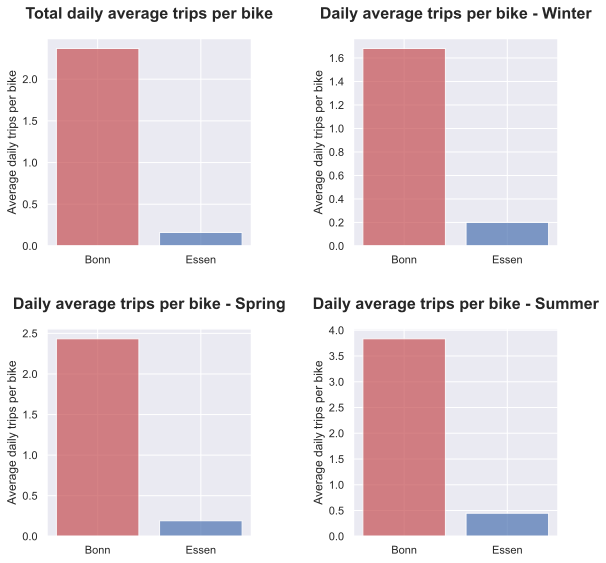

In [52]:
## Counting days per season
# Total
total_days = df_bonn['timestamp'].dt.date.nunique()
# Winter
winter_days = df_bonn_winter['timestamp'].dt.date.nunique()
# Spring
spring_days = df_bonn_spring['timestamp'].dt.date.nunique()
# Summer
summer_days = df_bonn_summer['timestamp'].dt.date.nunique()

## Calculating averages
# Total
daily_trips_per_bike_bonn = trips_per_bike_bonn / total_days
daily_trips_per_bike_essen = trips_per_bike_essen / total_days
avg_daily_trips_per_bike_combined = (daily_trips_per_bike_bonn, daily_trips_per_bike_essen)

# Winter
daily_trips_per_bike_bonn_winter = trips_per_bike_bonn_winter / winter_days
daily_trips_per_bike_essen_winter = trips_per_bike_essen_winter / winter_days
avg_daily_trips_per_bike_combined_winter = (daily_trips_per_bike_bonn_winter, daily_trips_per_bike_essen_winter)

# Spring
daily_trips_per_bike_bonn_spring = trips_per_bike_bonn_spring / spring_days
daily_trips_per_bike_essen_spring = trips_per_bike_essen_spring / spring_days
avg_daily_trips_per_bike_combined_spring = (daily_trips_per_bike_bonn_spring, daily_trips_per_bike_essen_spring)

# Summer
daily_trips_per_bike_bonn_summer = trips_per_bike_bonn_summer / summer_days
daily_trips_per_bike_essen_summer = trips_per_bike_essen_summer / summer_days
avg_daily_trips_per_bike_combined_summer = (daily_trips_per_bike_bonn_summer, daily_trips_per_bike_essen_summer)

## Plot results
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2,2,figsize=(8,8))

# Total
ax1.bar(cities, avg_daily_trips_per_bike_combined, color=['C3','C0'], alpha=0.7)
ax1.set_ylabel("Average daily trips per bike")
ax1.set_title("Total daily average trips per bike", fontsize=16, fontweight="bold", pad=20)

# Winter
ax2.bar(cities, avg_daily_trips_per_bike_combined_winter, color=['C3','C0'], alpha=0.7)
ax2.set_ylabel("Average daily trips per bike")
ax2.set_title("Daily average trips per bike - Winter", fontsize=16, fontweight="bold", pad=20)

# Spring
ax3.bar(cities, avg_daily_trips_per_bike_combined_spring, color=['C3','C0'], alpha=0.7)
ax3.set_ylabel("Average daily trips per bike")
ax3.set_title("Daily average trips per bike - Spring", fontsize=16, fontweight="bold", pad=20)

# Summer
ax4.bar(cities, avg_daily_trips_per_bike_combined_summer, color=['C3','C0'], alpha=0.7)
ax4.set_ylabel("Average daily trips per bike")
ax4.set_title("Daily average trips per bike - Summer", fontsize=16, fontweight="bold", pad=20)

fig.tight_layout()
fig.subplots_adjust(wspace=0.5, hspace=0.4)

These findings are clear indicators for perfomance differences in between Bonn and Essen. On avarage, a bike in Bonn (2,34 daily trips per bike) gets around 14 times more often rented than in Essen (0.16 daily trips per bike). In perspective of these findings, Bonn's nextbike fleet has a way higher performance than Essen's nextbike fleet.

## 2: Most popular Ridetimes

### Bonn

In [111]:
#data preparation 
#total trips time period
total_trips_bonn = df_bonn.groupby(['city','hour']).size().reset_index(name='total_trips')
total_trips_bonn['proportion'] = 0
total_trips_bonn['proportion'] = (total_trips_bonn['total_trips'] / total_trips_bonn['total_trips'].sum()) * 100

#weekly total trips
total_trips_bonn_week = df_bonn.groupby(['city','weekday']).size().reset_index(name='total_trips')
total_trips_bonn_week['proportion'] = 0
total_trips_bonn_week['proportion'] = (total_trips_bonn_week['total_trips']/total_trips_bonn_week['total_trips'].sum())*100

#hourly total trips  
total_trips_bonn_seasons = df_bonn.groupby(['season', 'hour'])['b_number'].count().reset_index(name='total_trips')
total_trips_bonn_seasons['total_trips_season'] = 0
total_trips_bonn_seasons['total_trips_season'] = total_trips_bonn_seasons['season'].apply(lambda x: total_trips_bonn_seasons['total_trips'].loc[total_trips_bonn_seasons['season'] == x].sum())
total_trips_bonn_seasons['proportion'] = 0
total_trips_bonn_seasons['proportion'] = (total_trips_bonn_seasons['total_trips']/total_trips_bonn_seasons['total_trips_season'])*100


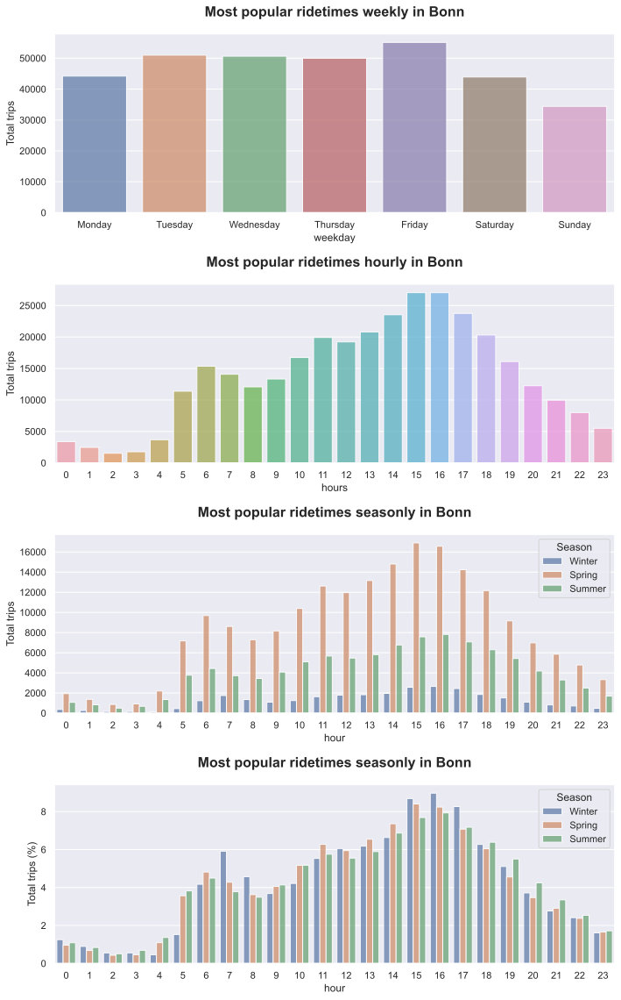

In [114]:
fig, ((ax1, ax2, ax3, ax4)) = plt.subplots(4,1,figsize=(10,16))

sns.barplot(x='weekday', y='total_trips', data=total_trips_bonn_week, ax=ax1, alpha=0.7)
ax1.set_xticklabels(weekdays.values())
ax1.set_xlabel('weekday')
ax1.set_ylabel('Total trips')
ax1.set_title('Most popular ridetimes weekly in Bonn', fontsize=16, fontweight="bold", pad=20)

sns.barplot(x='hour', y='total_trips', data=total_trips_bonn, ax=ax2, alpha=0.7)
ax2.set_xlabel('hours')
ax2.set_ylabel('Total trips')
ax2.set_title('Most popular ridetimes hourly in Bonn', fontsize=16, fontweight="bold", pad=20)

sns.barplot(x='hour', y='total_trips', hue='season', data=total_trips_bonn_seasons, ax=ax3, alpha=0.7)
ax3.set_xlabel('hour')
ax3.set_ylabel('Total trips')
h3, l3 = ax3.get_legend_handles_labels()
ax3.legend(h3, seasons.values(), title="Season")
ax3.set_title('Most popular ridetimes seasonly in Bonn', fontsize=16, fontweight="bold", pad=20)

sns.barplot(x='hour', y='proportion', hue='season', data=total_trips_bonn_seasons, ax=ax4, alpha=0.7)
ax4.set_xlabel('hour')
ax4.set_ylabel('Total trips (%)')
h4, l4 = ax4.get_legend_handles_labels()
ax4.legend(h4, seasons.values(), title="Season")
ax4.set_title('Most popular ridetimes seasonly in Bonn', fontsize=16, fontweight="bold", pad=20)

fig.tight_layout()
fig.subplots_adjust(hspace=0.4)

### Essen 

In [115]:
#data preparation 
#total trips time period
total_trips_essen = df_essen.groupby(['city','hour']).size().reset_index(name='total_trips')
total_trips_essen['proportion'] = 0
total_trips_essen['proportion'] = (total_trips_essen['total_trips'] / total_trips_essen['total_trips'].sum()) * 100

#weekly total trips
total_trips_essen_week = df_essen.groupby(['city','weekday']).size().reset_index(name='total_trips')
total_trips_essen_week['proportion'] = 0
total_trips_essen_week['proportion'] = (total_trips_essen_week['total_trips']/total_trips_essen_week['total_trips'].sum())*100

#hourly total trips  
total_trips_essen_seasons = df_essen.groupby(['season', 'hour'])['b_number'].count().reset_index(name='total_trips')
total_trips_essen_seasons['total_trips_season'] = 0
total_trips_essen_seasons['total_trips_season'] = total_trips_essen_seasons['season'].apply(lambda x: total_trips_essen_seasons['total_trips'].loc[total_trips_essen_seasons['season'] == x].sum())
total_trips_essen_seasons['proportion'] = 0
total_trips_essen_seasons['proportion'] = (total_trips_essen_seasons['total_trips']/total_trips_essen_seasons['total_trips_season'])*100

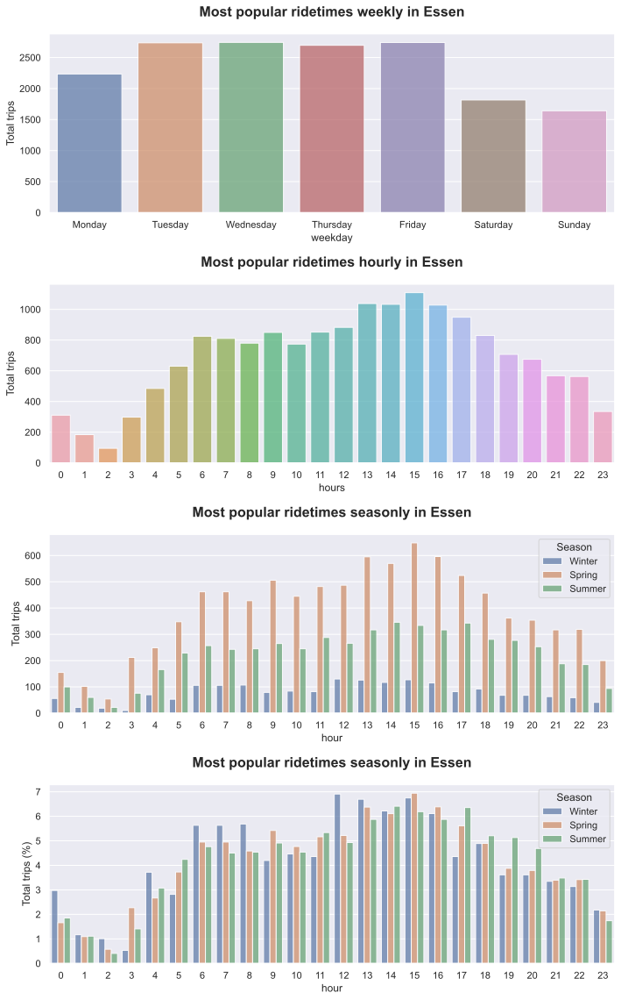

In [60]:

fig, ((ax1, ax2, ax3, ax4)) = plt.subplots(4,1,figsize=(10,16))

sns.barplot(x='weekday', y='total_trips', data=total_trips_essen_week, ax=ax1, alpha=0.7)
ax1.set_xticklabels(weekdays.values())
ax1.set_xlabel('weekday')
ax1.set_ylabel('Total trips')
ax1.set_title('Most popular ridetimes weekly in Essen', fontsize=16, fontweight="bold", pad=20)

sns.barplot(x='hour', y='total_trips', data=total_trips_essen, ax=ax2, alpha=0.7)
ax2.set_xlabel('hours')
ax2.set_ylabel('Total trips')
ax2.set_title('Most popular ridetimes hourly in Essen', fontsize=16, fontweight="bold", pad=20)

sns.barplot(x='hour', y='total_trips', hue='season', data=total_trips_essen_seasons, ax=ax3, alpha=0.7)
ax3.set_xlabel('hour')
ax3.set_ylabel('Total trips')
h3, l3 = ax3.get_legend_handles_labels()
ax3.legend(h3, seasons.values(), title="Season")
ax3.set_title('Most popular ridetimes seasonly in Essen', fontsize=16, fontweight="bold", pad=20)

sns.barplot(x='hour', y='proportion', hue='season', data=total_trips_essen_seasons, ax=ax4, alpha=0.7)
ax4.set_xlabel('hour')
ax4.set_ylabel('Total trips (%)')
h4, l4 = ax4.get_legend_handles_labels()
ax4.legend(h4, seasons.values(), title="Season")
ax4.set_title('Most popular ridetimes seasonly in Essen', fontsize=16, fontweight="bold", pad=20)

fig.tight_layout()
fig.subplots_adjust(hspace=0.4)

### Comparision

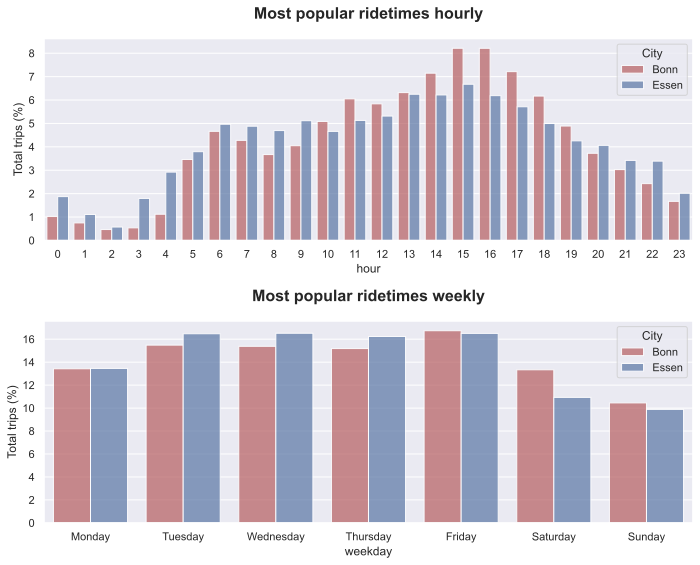

In [62]:
clrs= ['C3', 'C0']

fig, ((ax1, ax2)) = plt.subplots(2,1,figsize=(10,8))
sns.barplot(x='hour', y='proportion', hue='city', data=pd.concat([df, ef]), ax=ax1, palette=clrs, alpha=0.7)
ax1.set_ylabel('Total trips (%)')
ax1.legend(title="City")
ax1.set_title('Most popular ridetimes hourly', fontsize=16, fontweight="bold", pad=20)

sns.barplot(x='weekday', y='proportion', hue='city', data=pd.concat([df_w, ef_w]), ax=ax2, palette=clrs, alpha=0.7)
ax2.set_xticklabels(weekdays.values())
ax2.set_ylabel('Total trips (%)')
ax2.legend(title="City")
ax2.set_title('Most popular ridetimes weekly', fontsize=16, fontweight="bold", pad=20)

fig.tight_layout()
fig.subplots_adjust(hspace=0.4)

## 3: Trip Duration

### Bonn

In [64]:
df_bonn_trip_duration = pd.DataFrame(columns = ['time','trip_duration','season'])
df_bonn_trip_duration['time'] = df_bonn['timestamp'].dt.hour
df_bonn_trip_duration['trip_duration'] = df_bonn['trip_duration']
df_bonn_trip_duration['trip_duration'] = df_bonn_trip_duration['trip_duration'] / np.timedelta64(1, 'm')
df_bonn_trip_duration['season'] = df_bonn['season']

In [66]:
#Mean of trip duration
meanTripDurationBonn = df_bonn_trip_duration["trip_duration"].mean()

print("Mean Bonn:")
print(meanTripDurationBonn)

Mean Bonn:
13.07885691034198


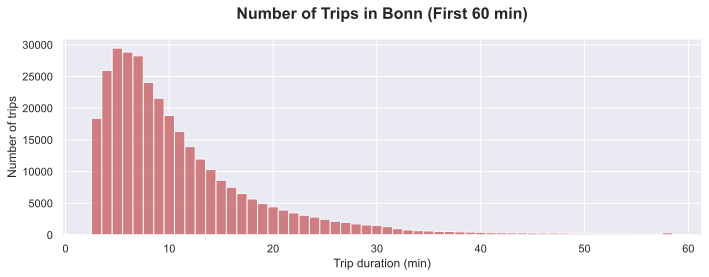

In [68]:
fig = plt.figure(figsize=(10,4))
ax = df_bonn_trip_duration['trip_duration'].hist(bins=range(int(df_bonn_trip_duration['trip_duration'].min()), 60), 
                    alpha=0.7, 
                    align ='left', 
                    color='C3')
ax.set_xlabel('Trip duration (min)')
ax.set_ylabel('Number of trips')
ax.set_title('Number of Trips in Bonn (First 60 min)', fontsize=16, fontweight='bold',pad=20)
fig.tight_layout()

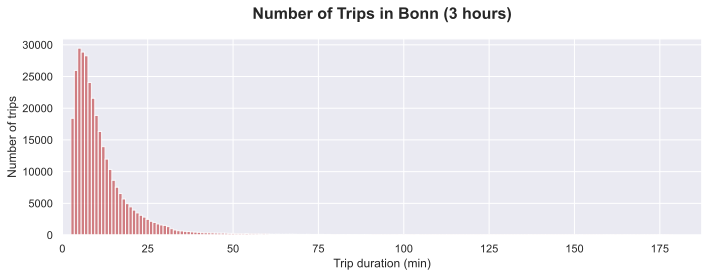

In [70]:
fig = plt.figure(figsize=(10,4))
ax = df_bonn_trip_duration['trip_duration'].hist(bins=range(int(df_bonn_trip_duration['trip_duration'].min()), 180),
                    alpha=0.7, 
                    align ='left',
                    color='C3')
ax.set_xlabel('Trip duration (min)')
ax.set_ylabel('Number of trips')
ax.set_xlim(0,)
ax.set_title('Number of Trips in Bonn (3 hours)', fontsize=16, fontweight='bold',pad=20)
fig.tight_layout()

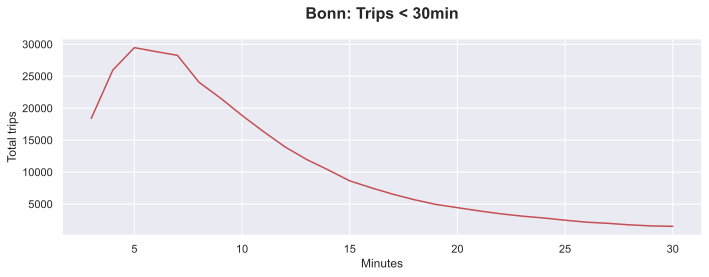

In [72]:
#Show all trips < 30 min in Bonn
fig = plt.figure(figsize=(10,4))
plt.plot('trip_duration', 
              'season', 
              data = df_bonn_trip_duration.loc[df_bonn_trip_duration['trip_duration']<=30].groupby('trip_duration')['season'].count().reset_index(), label = "Bonn", color='C3')
plt.xlabel('Minutes')
plt.ylabel('Total trips')
plt.title ('Bonn: Trips < 30min', fontsize=16, fontweight='bold',pad=20)
fig.tight_layout()

Let's look at the seasonal data

In [74]:
df_bonn_trip_duration_winter = df_bonn[['time', 'trip_duration', 'season']].loc[df_bonn['season'] == 0]
df_bonn_trip_duration_winter['trip_duration'] = df_bonn_trip_duration_winter['trip_duration'] / np.timedelta64(1, 'm')

df_bonn_trip_duration_spring = df_bonn[['time', 'trip_duration', 'season']].loc[df_bonn['season'] == 1]
df_bonn_trip_duration_spring['trip_duration'] = df_bonn_trip_duration_spring['trip_duration'] / np.timedelta64(1, 'm')

df_bonn_trip_duration_summer = df_bonn[['time', 'trip_duration', 'season']].loc[df_bonn['season'] == 2]
df_bonn_trip_duration_summer ['trip_duration'] = df_bonn_trip_duration_summer ['trip_duration'] / np.timedelta64(1, 'm')

In [76]:
#Mean of trip duration
meanTripDurationBonnWinter = df_bonn_trip_duration_winter["trip_duration"].mean()
meanTripDurationBonnSpring = df_bonn_trip_duration_spring["trip_duration"].mean()
meanTripDurationBonnSummer = df_bonn_trip_duration_summer["trip_duration"].mean()

print("Mean Bonn:")
print(meanTripDurationBonnWinter)
print(meanTripDurationBonnSpring)
print(meanTripDurationBonnSummer)

Mean Bonn:
12.214858418755709
12.771486656427234
13.965245090082778


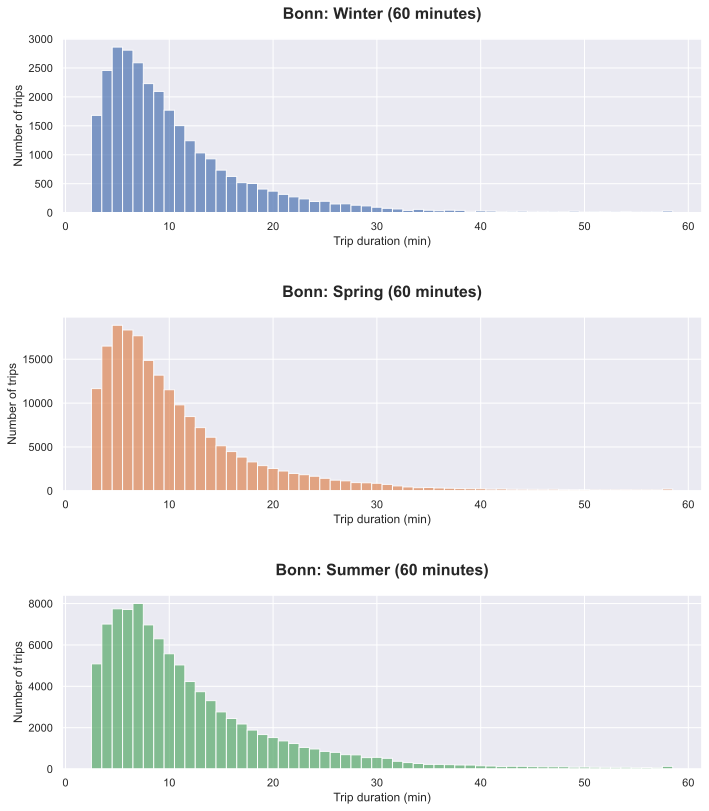

In [78]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize = (10,12))
df_bonn_trip_duration_winter['trip_duration'].hist(bins=range(int(df_bonn_trip_duration_winter['trip_duration'].min()), 60),
                    alpha=0.7, 
                    align ='left',
                    ax=ax1)
ax1.set_xlabel('Trip duration (min)')
ax1.set_ylabel('Number of trips')
ax1.set_title('Bonn: Winter (60 minutes)', fontsize=16, fontweight='bold',pad=20)

df_bonn_trip_duration_spring['trip_duration'].hist(bins=range(int(df_bonn_trip_duration_spring['trip_duration'].min()), 60), 
                     alpha=0.7, 
                     align ='left', 
                     ax=ax2, 
                     color='C1')
ax2.set_xlabel('Trip duration (min)')
ax2.set_ylabel('Number of trips')
ax2.set_title('Bonn: Spring (60 minutes)', fontsize=16, fontweight='bold',pad=20)

df_bonn_trip_duration_summer['trip_duration'].hist(bins=range(int(df_bonn_trip_duration_summer['trip_duration'].min()), 60), 
                     alpha=0.7, 
                     align ='left', 
                     ax=ax3, 
                     color='C2')
ax3.set_xlabel('Trip duration (min)')
ax3.set_ylabel('Number of trips')
ax3.set_title('Bonn: Summer (60 minutes)', fontsize=16, fontweight='bold',pad=20)

fig.tight_layout()
fig.subplots_adjust(hspace=0.6, top=0.9)

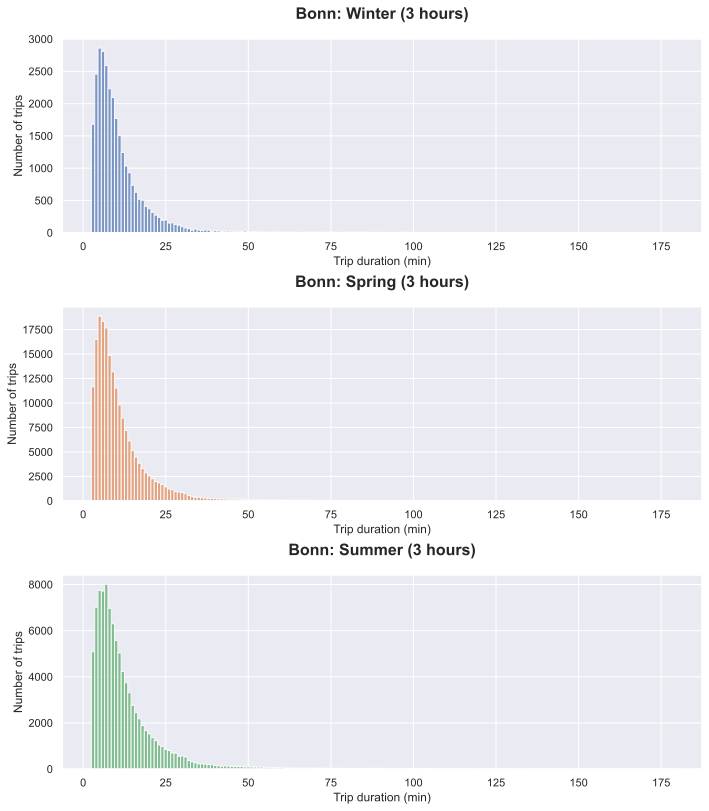

In [80]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize = (10,12))
df_bonn_trip_duration_winter['trip_duration'].hist(bins=range(int(df_bonn_trip_duration_winter['trip_duration'].min()), 180),
                    alpha=0.7, 
                    align ='left', 
                    ax=ax1)
ax1.set_xlabel('Trip duration (min)')
ax1.set_ylabel('Number of trips')
ax1.set_title('Bonn: Winter (3 hours)', fontsize=16, fontweight='bold',pad=20)

df_bonn_trip_duration_spring['trip_duration'].hist(bins=range(int(df_bonn_trip_duration_spring['trip_duration'].min()), 180), 
                     alpha=0.7, 
                     align ='left', 
                     ax=ax2, 
                     color='C1')
ax2.set_xlabel('Trip duration (min)')
ax2.set_ylabel('Number of trips')
ax2.set_title('Bonn: Spring (3 hours)', fontsize=16, fontweight='bold',pad=20)

df_bonn_trip_duration_summer['trip_duration'].hist(bins=range(int(df_bonn_trip_duration_summer['trip_duration'].min()), 180), 
                     alpha=0.7, 
                     align ='left', 
                     ax=ax3, 
                     color='C2')
ax3.set_xlabel('Trip duration (min)')
ax3.set_ylabel('Number of trips')
ax3.set_title('Bonn: Summer (3 hours)', fontsize=16, fontweight='bold',pad=20)

fig.tight_layout()
fig.subplots_adjust(top=0.9)

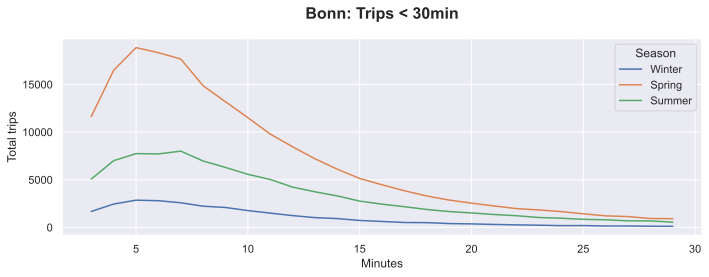

In [82]:
clrs = ['C0','C1','C2']

fig = plt.figure(figsize=(10,4))
ax1 = sns.lineplot(x='trip_duration', y='total_trips', data=df_bonn_trip_duration.loc[df_bonn_trip_duration['trip_duration']<30].groupby(['trip_duration', 'season'])['time'].count().reset_index(name='total_trips'), hue='season', palette=clrs)
ax1.set_xlabel('Minutes')
ax1.set_ylabel('Total trips')
h1, l1 = ax1.get_legend_handles_labels()
ax1.legend(h1, seasons.values(), title="Season")
ax1.set_title ('Bonn: Trips < 30min', fontsize=16, fontweight='bold',pad=20)
fig.tight_layout()

### Essen

In [84]:
df_essen_trip_duration = pd.DataFrame(columns = ['time','trip_duration','season'])
df_essen_trip_duration['time'] = df_essen['timestamp'].dt.hour
df_essen_trip_duration['trip_duration'] = df_essen['trip_duration']
df_essen_trip_duration['trip_duration'] = df_essen_trip_duration['trip_duration'] / np.timedelta64(1, 'm')
df_essen_trip_duration['season'] = df_essen['season']

In [86]:
#Mean of trip duration
meanTripDurationEssen = df_essen_trip_duration["trip_duration"].mean()

print("Mean Essen:")
print(meanTripDurationEssen)

Mean Essen:
28.83789803166195


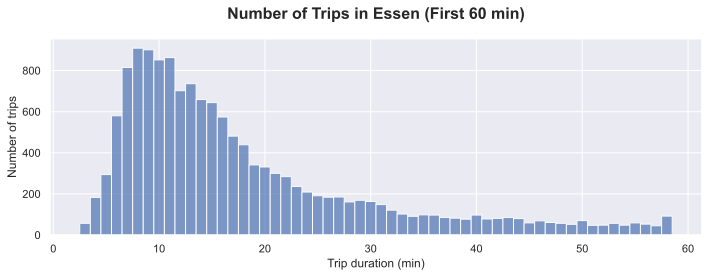

In [88]:
fig = plt.figure(figsize=(10,4))
ax = df_essen_trip_duration['trip_duration'].hist(bins=range(int(df_essen_trip_duration['trip_duration'].min()), 60), 
                     alpha=0.7, 
                     align ='left', 
                     color='C0')
ax.set_xlabel('Trip duration (min)')
ax.set_ylabel('Number of trips')
ax.set_title('Number of Trips in Essen (First 60 min)', fontsize=16, fontweight='bold',pad=20)
fig.tight_layout()

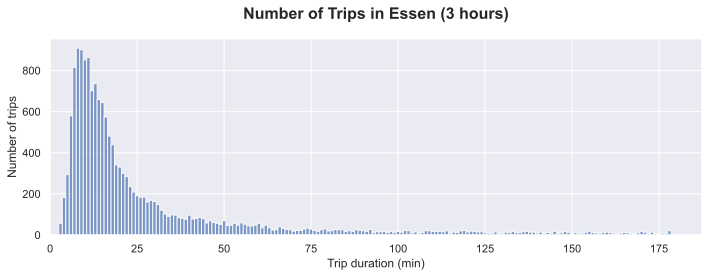

In [90]:
fig = plt.figure(figsize=(10,4))
ax = df_essen_trip_duration['trip_duration'].hist(bins=range(int(df_essen_trip_duration['trip_duration'].min()), 180), 
                     alpha=0.7, 
                     align ='left')
ax.set_xlabel('Trip duration (min)')
ax.set_xlim(0,)
ax.set_ylabel('Number of trips')
ax.set_title('Number of Trips in Essen (3 hours)', fontsize=16, fontweight='bold',pad=20)
fig.tight_layout()

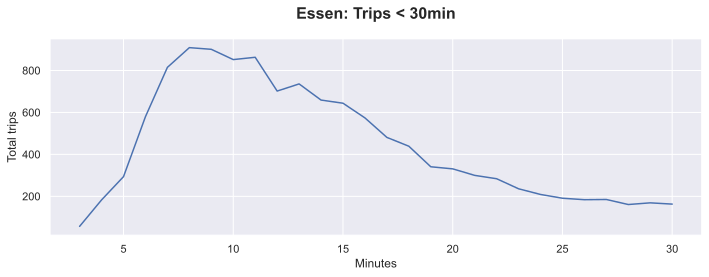

In [92]:
#Show all trips < 40 min in Essen
fig = plt.figure(figsize=(10,4))
plt.plot('trip_duration', 'season', data = df_essen_trip_duration.loc[df_essen_trip_duration['trip_duration']<=30].groupby('trip_duration')['season'].count().reset_index()[:38], label = "Essen", color='C0')
plt.xlabel('Minutes')
plt.ylabel('Total trips')
plt.title ('Essen: Trips < 30min', fontsize=16, fontweight='bold',pad=20)
fig.tight_layout()

Let's look at the seasonal data 


In [94]:
df_essen_trip_duration_winter = df_essen[['time', 'trip_duration', 'season']].loc[df_essen['season'] == 0]
df_essen_trip_duration_winter['trip_duration'] = df_essen_trip_duration_winter['trip_duration'] / np.timedelta64(1, 'm')

df_essen_trip_duration_spring = df_essen[['time', 'trip_duration', 'season']].loc[df_essen['season'] == 1]
df_essen_trip_duration_spring['trip_duration'] = df_essen_trip_duration_spring['trip_duration'] / np.timedelta64(1, 'm')

df_essen_trip_duration_summer = df_essen[['time', 'trip_duration', 'season']].loc[df_essen['season'] == 2]
df_essen_trip_duration_summer ['trip_duration'] = df_essen_trip_duration_summer ['trip_duration'] / np.timedelta64(1, 'm')

In [96]:
#Mean of trip duration
meanTripDurationEssenWinter = df_essen_trip_duration_winter["trip_duration"].mean()
meanTripDurationEssenSpring = df_essen_trip_duration_spring["trip_duration"].mean()
meanTripDurationEssenSummer = df_essen_trip_duration_summer["trip_duration"].mean()

print("Mean Essen:")
print(meanTripDurationEssenWinter)
print(meanTripDurationEssenSpring)
print(meanTripDurationEssenSummer)

Mean Essen:
28.983528161530288
28.35761731304907
29.6177506021864


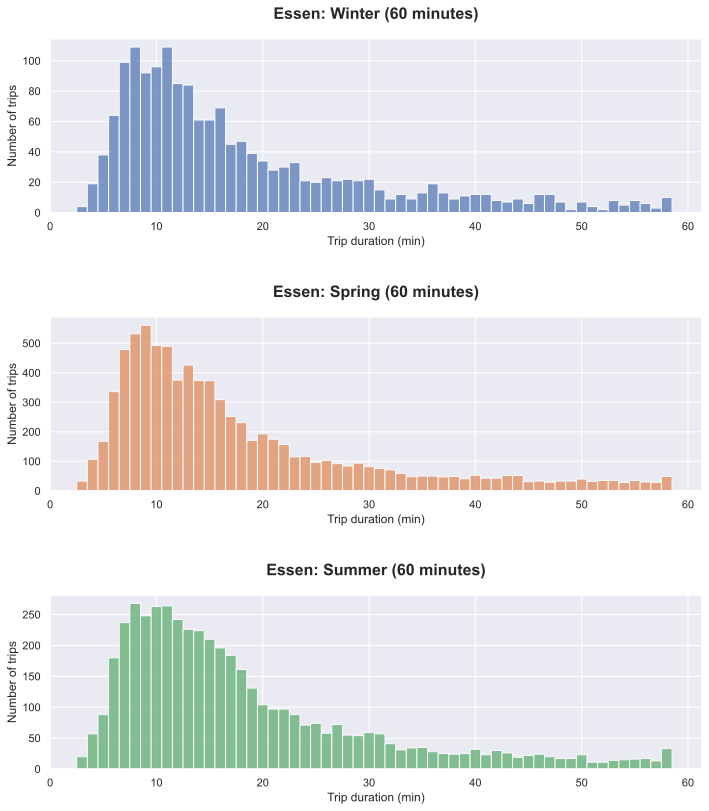

In [98]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize = (10,12))
df_essen_trip_duration_winter['trip_duration'].hist(bins=range(int(df_essen_trip_duration_winter['trip_duration'].min()), 60),
                    alpha=0.7, 
                    align ='left', 
                    ax=ax1)
ax1.set_xlim(0,)
ax1.set_xlabel('Trip duration (min)')
ax1.set_ylabel('Number of trips')
ax1.set_title('Essen: Winter (60 minutes)', fontsize=16, fontweight='bold',pad=20)

df_essen_trip_duration_spring['trip_duration'].hist(bins=range(int(df_essen_trip_duration_spring['trip_duration'].min()), 60), 
                     alpha=0.7, 
                     align ='left', 
                     ax=ax2, 
                     color='C1')
ax2.set_xlim(0,)
ax2.set_xlabel('Trip duration (min)')
ax2.set_ylabel('Number of trips')
ax2.set_title('Essen: Spring (60 minutes)', fontsize=16, fontweight='bold',pad=20)

df_essen_trip_duration_summer['trip_duration'].hist(bins=range(int(df_essen_trip_duration_summer['trip_duration'].min()), 60), 
                     alpha=0.7, 
                     align ='left', 
                     ax=ax3, 
                     color='C2')
ax3.set_xlim(0,)
ax3.set_xlabel('Trip duration (min)')
ax3.set_ylabel('Number of trips')
ax3.set_title('Essen: Summer (60 minutes)', fontsize=16, fontweight='bold',pad=20)

fig.tight_layout()
fig.subplots_adjust(hspace=0.6, top=0.9)

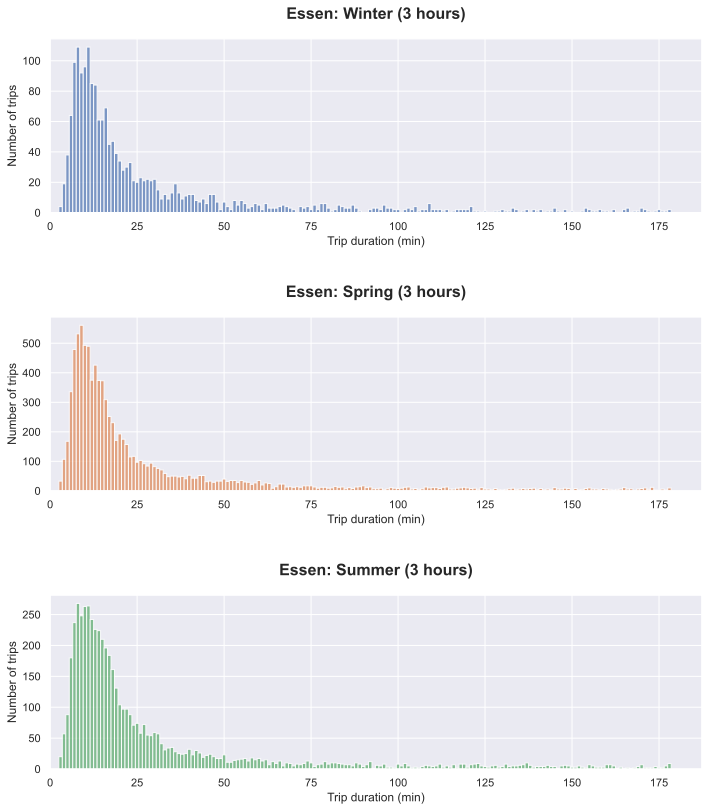

In [100]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize = (10,12))
df_essen_trip_duration_winter['trip_duration'].hist(bins=range(int(df_essen_trip_duration_winter['trip_duration'].min()), 180),
                    alpha=0.7, 
                    align ='left', 
                    ax=ax1)
ax1.set_xlim(0,)
ax1.set_xlabel('Trip duration (min)')
ax1.set_ylabel('Number of trips')
ax1.set_title('Essen: Winter (3 hours)', fontsize=16, fontweight='bold',pad=20)

df_essen_trip_duration_spring['trip_duration'].hist(bins=range(int(df_essen_trip_duration_spring['trip_duration'].min()), 180), 
                     alpha=0.7, 
                     align ='left', 
                     ax=ax2, 
                     color='C1')
ax2.set_xlim(0,)
ax2.set_xlabel('Trip duration (min)')
ax2.set_ylabel('Number of trips')
ax2.set_title('Essen: Spring (3 hours)', fontsize=16, fontweight='bold',pad=20)

df_essen_trip_duration_summer['trip_duration'].hist(bins=range(int(df_essen_trip_duration_summer['trip_duration'].min()), 180), 
                     alpha=0.7, 
                     align ='left', 
                     ax=ax3, 
                     color='C2')
ax3.set_xlim(0,)
ax3.set_xlabel('Trip duration (min)')
ax3.set_ylabel('Number of trips')
ax3.set_title('Essen: Summer (3 hours)', fontsize=16, fontweight='bold',pad=20)

fig.tight_layout()
fig.subplots_adjust(hspace=0.6, top=0.9)

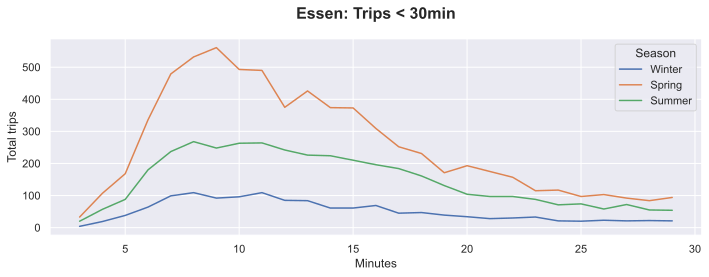

In [102]:
clrs = ['C0','C1','C2']

fig = plt.figure(figsize=(10,4))
ax1 = sns.lineplot(x='trip_duration', y='total_trips', data=df_essen_trip_duration.loc[df_essen_trip_duration['trip_duration']<30].groupby(['trip_duration', 'season'])['time'].count().reset_index(name='total_trips'), hue='season', palette=clrs)
ax1.set_xlabel('Minutes')
ax1.set_ylabel('Total trips')
h1, l1 = ax1.get_legend_handles_labels()
ax1.legend(h1, seasons.values(), title="Season")
ax1.set_title ('Essen: Trips < 30min', fontsize=16, fontweight='bold',pad=20)
fig.tight_layout()


### Comparision

In [104]:
#percentage of trips bonn
total_trips_bonn = df_bonn['b_number'].count()

proportion_trip_duration_bonn = df_bonn_trip_duration.groupby('trip_duration')['time'].count().reset_index(name='total_trips')
proportion_trip_duration_bonn['proportion'] = (proportion_trip_duration_bonn['total_trips'] /  total_trips_bonn) * 100 
proportion_trip_duration_bonn = proportion_trip_duration_bonn.loc[proportion_trip_duration_bonn['trip_duration'] < 30]
proportion_trip_duration_bonn['city'] = 'Bonn'


#percentage of trips 
total_trips_essen = df_essen['b_number'].count()

proportion_trip_duration_essen = df_essen_trip_duration.groupby('trip_duration')['time'].count().reset_index(name='total_trips')
proportion_trip_duration_essen['proportion'] = (proportion_trip_duration_essen['total_trips'] /  total_trips_essen) * 100 
proportion_trip_duration_essen = proportion_trip_duration_essen.loc[proportion_trip_duration_essen['trip_duration'] < 30]
proportion_trip_duration_essen['city'] = 'Essen'

proportion_trip_duration = pd.concat([proportion_trip_duration_bonn, proportion_trip_duration_essen])

In [ ]:
clrs= ['C3', 'C0']

fig = plt.figure(figsize=(4,4))
ax1 = sns.barplot(x='city', y='proportion', data=proportion_trip_duration.groupby('city')['proportion'].sum().reset_index(), palette=clrs, alpha=0.7)
ax1.set_ylabel('Total trips (%)')
ax1.set_xlabel('City')
ax1.set_title('Percentage of total trips < 30', fontsize=16, fontweight="bold", pad=20)
fig.tight_layout()
fig.subplots_adjust(hspace=0.4)

## 4: Utilization


#### Key Question 


How high is the utilization of the bike fleet? 

### Data preparation

Create all needed Data to determine KPI for both cities:
* bike\_usage\_*city* - Dataframe with information about the first and last trip of every bike. Used to calculate fleet size.
* daily\_uilization\_*city* - Dataframe with daily data about fleet size, maximum capacity of trips in minutes, trip minutes of fleet and utilization rate.
* hourly\_uilization\_*city* - Dataframe with hourly data about fleet size, maximum capacity of trips in minutes, trip minutes of fleet and utilization rate.

#### Bonn

In [59]:
# Create dataframe with date of first and last trip of every bike rented in Bonn

#get all bikes used per City 
bike_usage_bonn = pd.DataFrame(columns = ['b_number', 'first_trip', 'last_trip', 'unique_days_used', 'total_days'])

bike_usage_bonn['b_number'] = df_bonn['b_number'].unique()

bike_usage_bonn.set_index('b_number', inplace=True)

#get first trip date 
bike_usage_bonn['first_trip'] = df_bonn.groupby('b_number')['timestamp'].agg('min')
bike_usage_bonn['first_trip'] = bike_usage_bonn['first_trip'].apply(lambda row: row.normalize())

#get last trip
bike_usage_bonn['last_trip'] = df_bonn.groupby('b_number')['timestamp'].agg('max')
bike_usage_bonn['last_trip'] = bike_usage_bonn['last_trip'].apply(lambda row: row.normalize())

# unique days used

bike_usage_bonn['unique_days_used'] = df_bonn.groupby('b_number')['day'].nunique()


#total days between first and last trip
bike_usage_bonn['total_days'] = bike_usage_bonn['last_trip'] - bike_usage_bonn['first_trip']
bike_usage_bonn['total_days'] = bike_usage_bonn['total_days'].dt.days



In [61]:
#Creating hourly_utilization_bonn 

daily_utilization_bonn = pd.DataFrame(columns = ['timestamp', 'fleet', 'max_capacity', 'utilization','capacity_utilization_rate', 'weekday', 'season'])

# timestamps as day
daily_utilization_bonn['timestamp'] = df_bonn['timestamp'].dt.normalize().unique()

# get fleet for the day
#fleet = every bike with a rent before and after the current date

for i in range (daily_utilization_bonn.shape[0]-1):
   daily_utilization_bonn['fleet'][i] = bike_usage_bonn[(daily_utilization_bonn['timestamp'][i]>= bike_usage_bonn['first_trip']) & (bike_usage_bonn['last_trip'] >= daily_utilization_bonn['timestamp'][i])].shape[0]
daily_utilization_bonn['fleet'] = daily_utilization_bonn["fleet"].apply(lambda row: pd.to_numeric(row))

# maximale possible trip time in minutes 
daily_utilization_bonn['max_capacity'] = daily_utilization_bonn['fleet']*24 * 60

# rent time in minutes
daily_trip_duration_bonn = df_bonn.groupby(pd.Grouper(key='timestamp', freq='D'))['trip_duration'].agg('sum').reset_index()
daily_utilization_bonn['utilization'] = daily_trip_duration_bonn.loc[daily_trip_duration_bonn['trip_duration'].dt.seconds != 0].reset_index()['trip_duration']
daily_utilization_bonn['utilization'] = (daily_utilization_bonn['utilization'].dt.days * 1440) + (daily_utilization_bonn['utilization'].dt.seconds / 60)

# capacity utilization rate 
daily_utilization_bonn['capacity_utilization_rate'] = pd.to_numeric(100 * daily_utilization_bonn['utilization'] / daily_utilization_bonn['max_capacity'])

# add weekdays and season
daily_utilization_bonn['weekday'] = daily_utilization_bonn["timestamp"].apply(lambda row: row.weekday())
daily_utilization_bonn["season"] = daily_utilization_bonn["timestamp"].apply(lambda row: row.month%12 // 3)



In [63]:
#Creating hourly_utilization_bonn 

hourly_utilization_bonn = pd.DataFrame(columns =['timestamp', 'hour', 'trips','fleet', 'utilization' ,'capacity_utilization_rate', 'idle_time', 'idle_time_rate', 'weekday', 'season'])

# timestamps as day
hourly_utilization_bonn['timestamp'] = hourly_utilization_bonn['timestamp'] 
hourly_utilization_bonn['timestamp'] = df_bonn['timestamp'].dt.normalize()
hourly_utilization_bonn['hour'] = df_bonn['hour']


hourly_utilization_bonn['utilization'] = df_bonn['trip_duration']
hourly_utilization_bonn = hourly_utilization_bonn.groupby(['timestamp', 'hour']).agg('sum').dropna().reset_index()
hourly_utilization_bonn['utilization'] = hourly_utilization_bonn['utilization'].dt.seconds / 60

# get fleet for the day
#fleet = every bike with a rent before and after the current date

for i in range (hourly_utilization_bonn.shape[0]-1):
   hourly_utilization_bonn['fleet'][i] = bike_usage_bonn[(hourly_utilization_bonn['timestamp'][i]>= bike_usage_bonn['first_trip']) & (bike_usage_bonn['last_trip'] >= hourly_utilization_bonn['timestamp'][i])].shape[0]
hourly_utilization_bonn['fleet'] = hourly_utilization_bonn["fleet"].apply(lambda row: pd.to_numeric(row))

# maximale possible trip time in minutes 
hourly_utilization_bonn['max_capacity'] = hourly_utilization_bonn['fleet'] * 60

# capacity utilization rate = % 
hourly_utilization_bonn['capacity_utilization_rate'] = pd.to_numeric(100 * hourly_utilization_bonn['utilization'] / hourly_utilization_bonn['max_capacity'])

# add weekdays and season
hourly_utilization_bonn['weekday'] = hourly_utilization_bonn["timestamp"].apply(lambda row: row.weekday())
hourly_utilization_bonn["season"] = hourly_utilization_bonn["timestamp"].apply(lambda row: row.month%12 // 3)
hourly_utilization_bonn = hourly_utilization_bonn.replace([np.inf, -np.inf], 0)
#daily_utilization_bonn = daily_utilization_bonn.set_index('timestamp')

#### Essen

In [65]:
# Create dataframe with date of first and last trip of every bike rented in Essen

#get all bikes rented in Essen 
bike_usage_essen = pd.DataFrame(columns = ['b_number', 'first_trip', 'last_trip',  'unique_days_used', 'total_days'])

bike_usage_essen['b_number'] = df_essen['b_number'].unique()

bike_usage_essen.set_index('b_number', inplace=True)

#get first trip date 
bike_usage_essen['first_trip'] = df_essen.groupby('b_number')['timestamp'].agg('min')
bike_usage_essen['first_trip'] = bike_usage_essen['first_trip'].apply(lambda row: row.normalize())

#get last trip
bike_usage_essen['last_trip'] = df_essen.groupby('b_number')['timestamp'].agg('max')
bike_usage_essen['last_trip'] = bike_usage_essen['last_trip'].apply(lambda row: row.normalize())

# unique days used

bike_usage_essen['unique_days_used'] = df_essen.groupby('b_number')['day'].nunique()


#total days between first and last trip
bike_usage_essen['total_days'] = bike_usage_essen['last_trip'] - bike_usage_essen['first_trip']
bike_usage_essen['total_days'] = bike_usage_essen['total_days'].dt.days

In [67]:
# Create dataframe daily_utilization_essen


daily_utilization_essen = pd.DataFrame(columns = ['timestamp', 'fleet', 'max_capacity', 'utilization','capacity_utilization_rate', 'weekday', 'season'])

# timestamps as day
daily_utilization_essen['timestamp'] = df_essen['timestamp'].dt.normalize().unique()

# get fleet for the day
#fleet = every bike with a rent before and after the current date

for i in range (daily_utilization_essen.shape[0]-1):
    daily_utilization_essen['fleet'][i] = bike_usage_essen[(daily_utilization_essen['timestamp'][i]>= bike_usage_essen['first_trip']) & (bike_usage_essen['last_trip'] >= daily_utilization_essen['timestamp'][i])].shape[0]
# maximale possible trip time in minutes 
daily_utilization_essen['max_capacity'] = daily_utilization_essen['fleet']*24 * 60

# rent time in minutes
daily_trip_duration_essen = df_essen.groupby(pd.Grouper(key='timestamp', freq='D'))['trip_duration'].agg('sum').reset_index()
daily_utilization_essen['utilization'] = daily_trip_duration_essen.loc[daily_trip_duration_essen['trip_duration'].dt.seconds != 0].reset_index()['trip_duration']
daily_utilization_essen['utilization'] = (daily_utilization_essen['utilization'].dt.days * 1440) + (daily_utilization_essen['utilization'].dt.seconds / 60)

# capacity utilization rate 
daily_utilization_essen['capacity_utilization_rate'] = pd.to_numeric(100 * daily_utilization_essen['utilization'] / daily_utilization_essen['max_capacity'])



# add weekdays and season
daily_utilization_essen['weekday'] = daily_utilization_essen["timestamp"].apply(lambda row: row.weekday())
daily_utilization_essen["season"] = daily_utilization_essen["timestamp"].apply(lambda row: row.month%12 // 3)



In [69]:
# Create dataframe daily_utilization_essen

hourly_utilization_essen = pd.DataFrame(columns =['timestamp', 'hour', 'trips','fleet', 'utilization' ,'capacity_utilization_rate', 'idle_time', 'idle_time_rate', 'weekday', 'season'])


# timestamps as day
#hourly_utilization_essen['timestamp'] = hourly_utilization_essen['timestamp'] 
hourly_utilization_essen['timestamp'] = df_essen['timestamp'].dt.normalize()
hourly_utilization_essen['hour'] = df_essen['hour']


hourly_utilization_essen['utilization'] = df_essen['trip_duration']
hourly_utilization_essen = hourly_utilization_essen.groupby(['timestamp', 'hour']).agg('sum').dropna().reset_index()
hourly_utilization_essen['utilization'] = hourly_utilization_essen['utilization'].dt.seconds / 60


# get fleet for the day
#fleet = every bike with a rent before and after the current date

for i in range (hourly_utilization_essen.shape[0]-1):
   hourly_utilization_essen['fleet'][i] = bike_usage_essen[(hourly_utilization_essen['timestamp'][i]>= bike_usage_essen['first_trip']) & (bike_usage_essen['last_trip'] >= hourly_utilization_essen['timestamp'][i])].shape[0]
hourly_utilization_essen['fleet'] = hourly_utilization_essen["fleet"].apply(lambda row: pd.to_numeric(row))

# maximale possible trip time in minutes 
hourly_utilization_essen['max_capacity'] = hourly_utilization_essen['fleet'] * 60

# capacity utilization rate 
hourly_utilization_essen['capacity_utilization_rate'] = pd.to_numeric(100 * hourly_utilization_essen['utilization'] / hourly_utilization_essen['max_capacity'])

# add weekdays and season
hourly_utilization_essen['weekday'] = hourly_utilization_essen["timestamp"].apply(lambda row: row.weekday())
hourly_utilization_essen["season"] = hourly_utilization_essen["timestamp"].apply(lambda row: row.month%12 // 3)
hourly_utilization_essen = hourly_utilization_essen.replace([np.inf, -np.inf], 0)
#daily_utilization_essen = daily_utilization_essen.set_index('timestamp')

### Fleet size

The provided raw data only provides us with all rented bikes per day but not with the number of available bikes. nextbike's API does not provide this data either. 
As a result we have to estimate the size of the fleet in order to calculate the utilization rate. Compared two approaches:
1. unique bikes with trips on the given day
2. bikes with a trip before and after the given date

We prefer the second approach due to a more stable curve progression.  


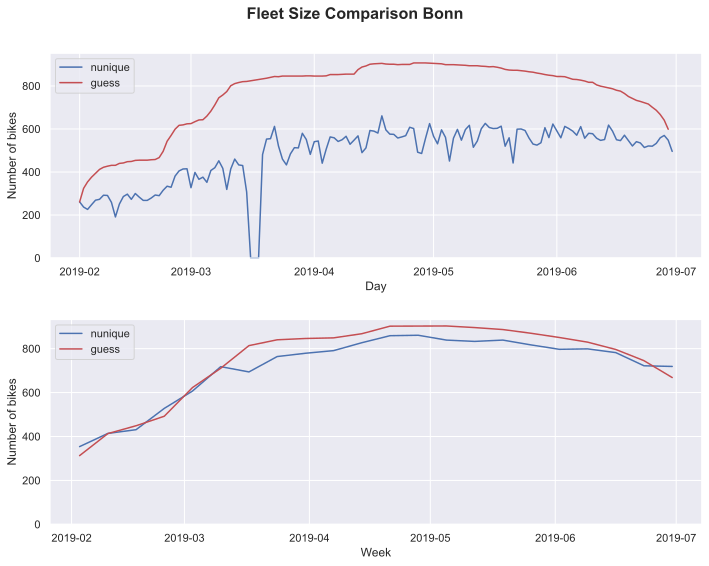

In [71]:
# Comparison of both approaches to estimate fleet size based on Bonn

fig, (ax1, ax2) = plt.subplots(2, figsize=(10,8))

ax1.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq='D'))['b_number'].nunique(), label ='nunique', color = 'C0')
ax1.plot(daily_utilization_bonn['timestamp'], daily_utilization_bonn['fleet'], label ='guess', color = 'C3')

ax1.set_title('', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Number of bikes')
ax1.set_ylim(0, )
ax1.legend()

ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq='W'))['b_number'].nunique(), label ='nunique', color = 'C0')
ax2.plot(daily_utilization_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['fleet'].mean(), label ='guess', color = 'C3')

ax2.set_xlabel('Week')
ax2.set_ylabel('Number of bikes')
ax2.set_ylim(0, )
ax2.legend()

fig.tight_layout()
fig.suptitle('Fleet Size Comparison Bonn', fontweight="bold", fontsize=16)
fig.subplots_adjust(top=0.9, hspace=0.3)

### Comparison of daily utilization rate of both cities 

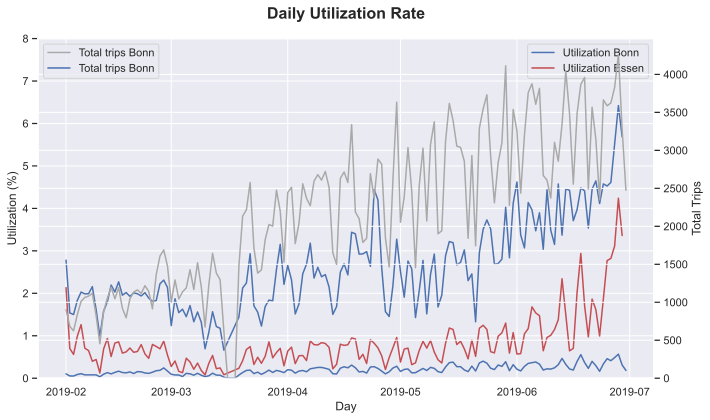

In [73]:
#daily utilization rate
fig, ax1 = plt.subplots(figsize=(10,6))


ax1.plot(daily_utilization_bonn['timestamp'] ,daily_utilization_bonn['capacity_utilization_rate'], label ='Utilization Bonn', color = 'C0')
ax1.plot(daily_utilization_essen['timestamp'], daily_utilization_essen['capacity_utilization_rate'], label ='Utilization Essen', color = 'C3')


ax1.set_title('Daily Utilization Rate', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()

#adds second y axis with total trips per city

ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq = 'D'))['b_number'].count(), label='Total trips Bonn', color = 'darkgray')
ax2.plot(df_essen.groupby(pd.Grouper(key='timestamp', freq = 'D'))['b_number'].count(), label='Total trips Bonn', color = 'C0')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)
ax2.legend()

fig.tight_layout()

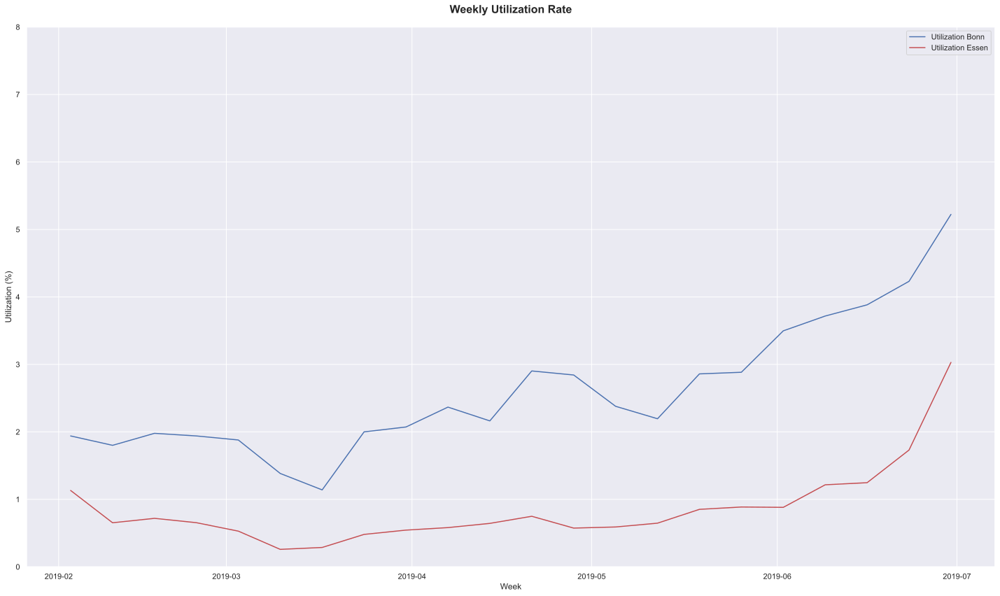

In [75]:
#weekly utilization rate

fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(daily_utilization_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['capacity_utilization_rate'].mean(), label ='Utilization Bonn', color = 'C0')
ax1.plot( daily_utilization_essen.groupby(pd.Grouper(key='timestamp', freq = 'W'))['capacity_utilization_rate'].mean(), label ='Utilization Essen', color = 'C3')

ax1.set_title('Weekly Utilization Rate', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Week')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()

#adds second y axis with total trips per city
'''
ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['b_number'].count(), color = 'darkgray', label='Total trips Bonn')
ax2.plot(df_essen.groupby(pd.Grouper(key='timestamp', freq = 'W'))['b_number'].count(), color = 'red', label='Total trips Bonn')
ax2.set_ylabel('Total Trips')
ax2.legend()
'''


fig.tight_layout()

#### Bonn - in Depth

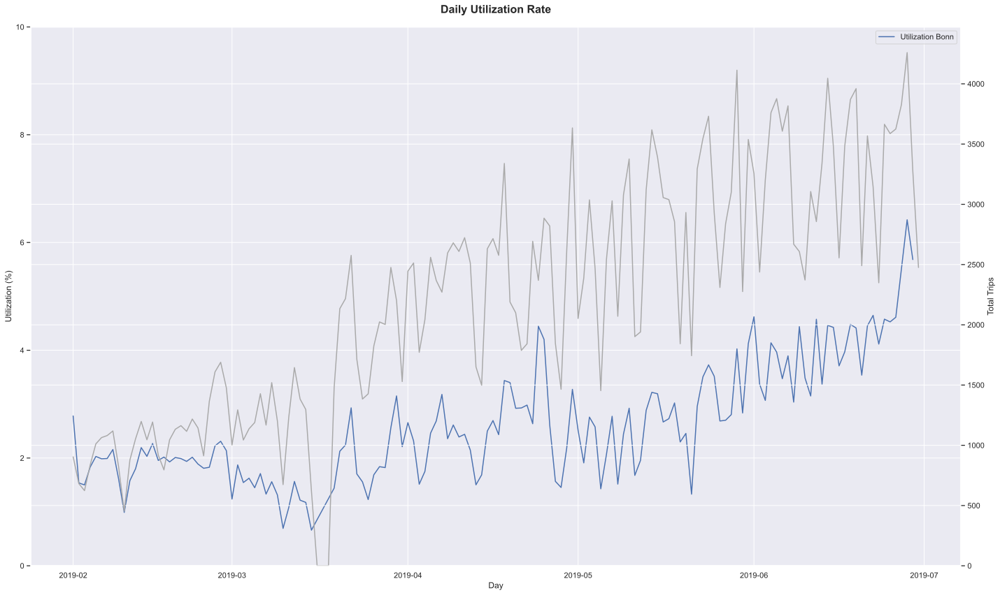

In [77]:
#daily utilization rate

fig, ax1 = plt.subplots(figsize=(20,12))


ax1.plot(daily_utilization_bonn['timestamp'] ,daily_utilization_bonn['capacity_utilization_rate'], label ='Utilization Bonn', color = 'C0')

ax1.set_title('Daily Utilization Rate', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,10)
ax1.legend()

ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq = 'D'))['b_number'].count(), color = 'darkgray', label='Total trips Bonn')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)

fig.tight_layout()

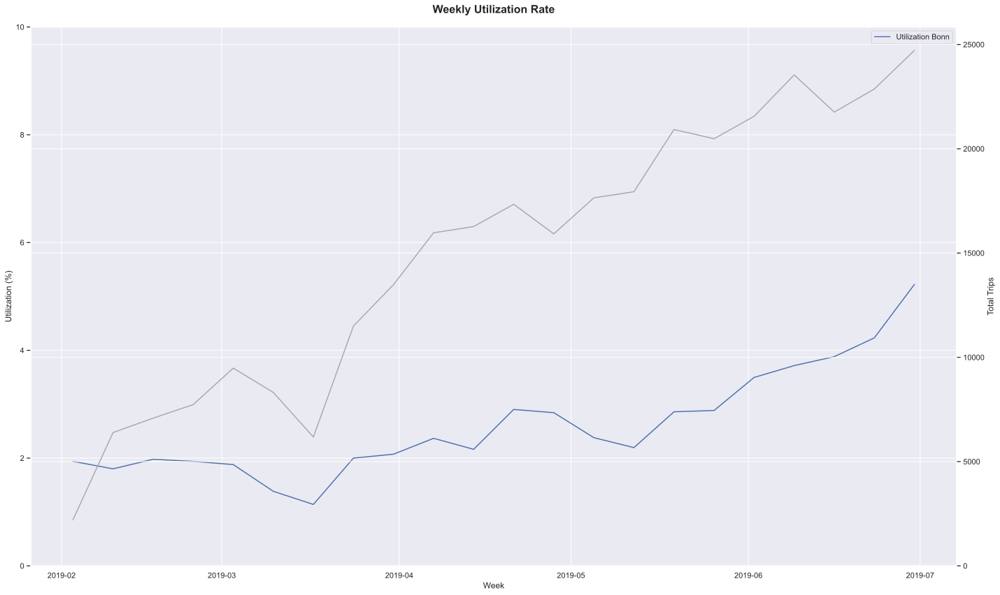

In [79]:
fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(daily_utilization_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['capacity_utilization_rate'].mean(), label ='Utilization Bonn', color = 'C0')
ax1.set_title('Weekly Utilization Rate', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Week')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,10)
ax1.legend()

ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['b_number'].count(), label='Total trips Bonn', color = 'darkgray')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)

fig.tight_layout()


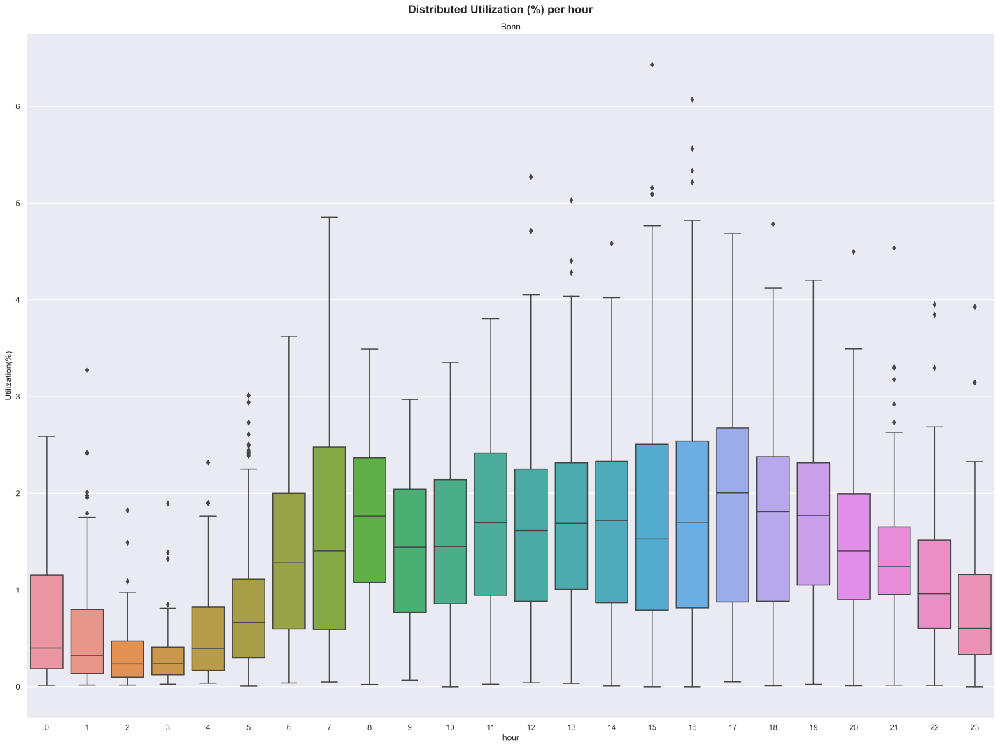

In [81]:
#mean hourly utilization in Bonn

fig, ax1 = plt.subplots(figsize=(20,15))

sns.boxplot(ax = ax1, x="hour", y="capacity_utilization_rate",
                    data=hourly_utilization_bonn)
fig.suptitle('Distributed Utilization (%) per hour', fontsize=16, fontweight="bold", va = 'center')

ax1.set_xlabel('hour')
ax1.set_ylabel('Utilization(%)')
ax1.set_title('Bonn')

fig.tight_layout()

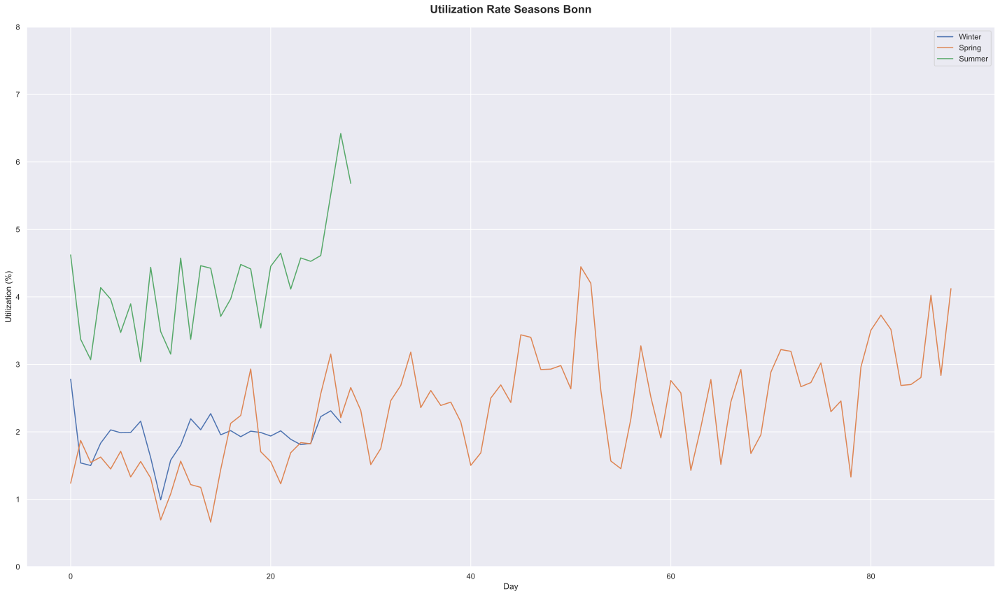

In [83]:
# Utilization rate per Season 
fig, ax1 = plt.subplots(figsize=(20,12))


ax1.plot(daily_utilization_bonn.loc[daily_utilization_bonn['season'] == 0].reset_index()['capacity_utilization_rate'], label ='Winter')
ax1.plot(daily_utilization_bonn.loc[daily_utilization_bonn['season'] == 1].reset_index()['capacity_utilization_rate'], label ='Spring')
ax1.plot(daily_utilization_bonn.loc[daily_utilization_bonn['season'] == 2].reset_index()['capacity_utilization_rate'], label ='Summer')


ax1.set_title('Utilization Rate Seasons Bonn', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()

fig.tight_layout()

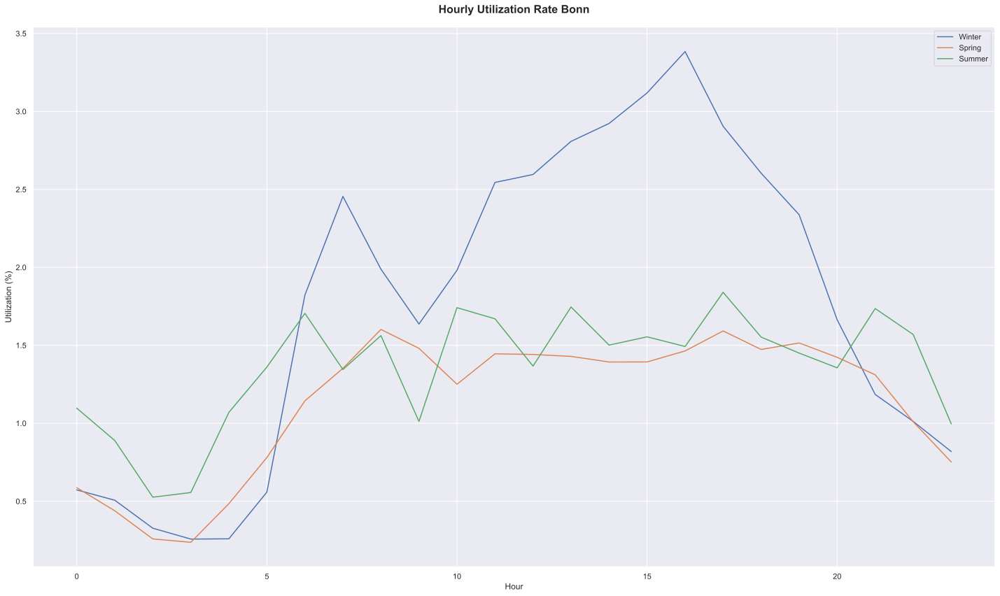

In [85]:
fig, ax1 = plt.subplots(figsize=(20,12))


ax1.plot(hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 0].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Winter')
ax1.plot(hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 1].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Spring')
ax1.plot(hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 2].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Summer')

ax1.set_title('Hourly Utilization Rate Bonn', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Hour')
ax1.set_ylabel('Utilization (%)')
#ax1.set_ylim(0,10)
ax1.legend()

fig.tight_layout()

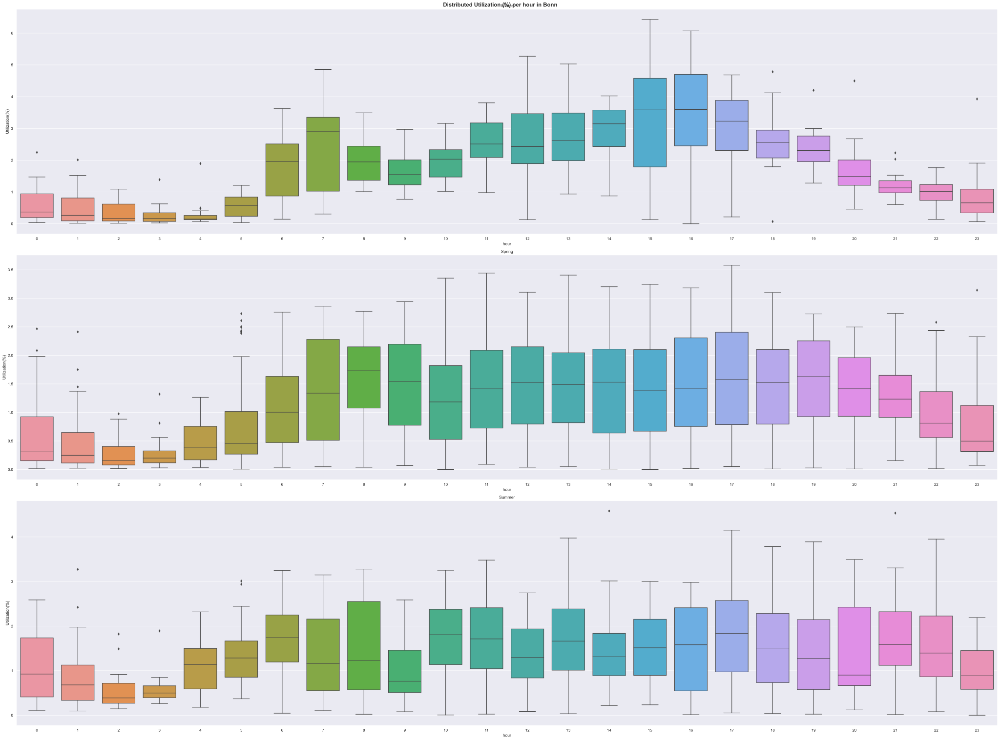

In [87]:
#mean hourly utilization in Bonn

fig, (ax1,ax2, ax3) = plt.subplots(3, figsize=(40,30))

sns.boxplot(ax = ax1, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 0])

fig.suptitle('Distributed Utilization (%) per hour in Bonn', fontsize=16, fontweight="bold", va = 'center')

ax1.set_xlabel('hour')
ax1.set_ylabel('Utilization(%)')
ax1.set_title('Winter')

sns.boxplot(ax = ax2, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 1])

ax2.set_xlabel('hour')
ax2.set_ylabel('Utilization(%)')
ax2.set_title('Spring')

sns.boxplot(ax = ax3, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 2])

ax3.set_xlabel('hour')
ax3.set_ylabel('Utilization(%)')
ax3.set_title('Summer')

fig.tight_layout()

#### Essen - in depth

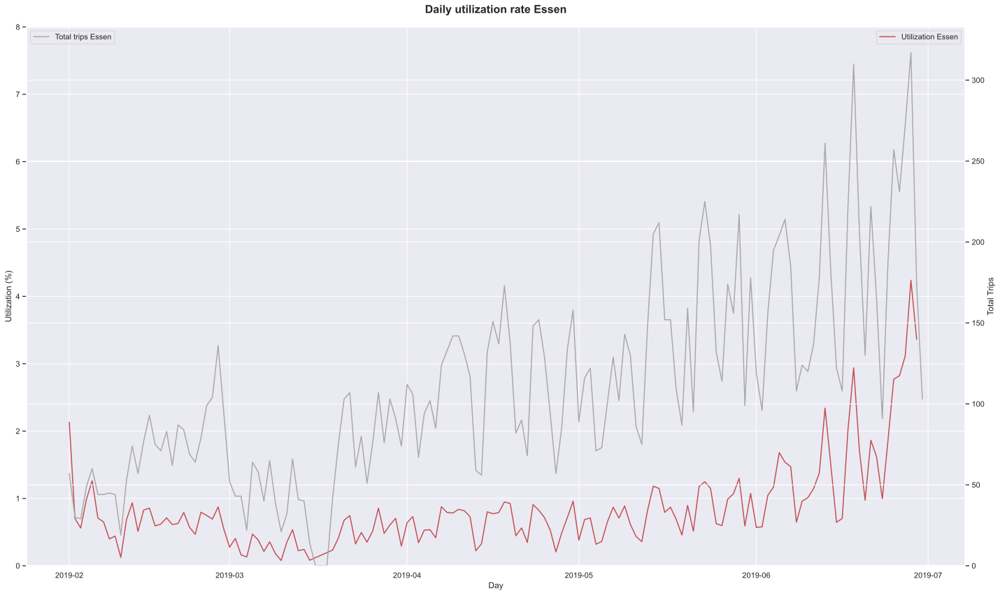

In [89]:
#daily utilization rate

fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(daily_utilization_essen['timestamp'], daily_utilization_essen['capacity_utilization_rate'], label ='Utilization Essen', color='C3')


ax1.set_title('Daily utilization rate Essen', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()

ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_essen.groupby(pd.Grouper(key='timestamp', freq = 'D'))['b_number'].count(), label='Total trips Essen', color = 'darkgray')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)
ax2.legend(loc=2)

fig.tight_layout()

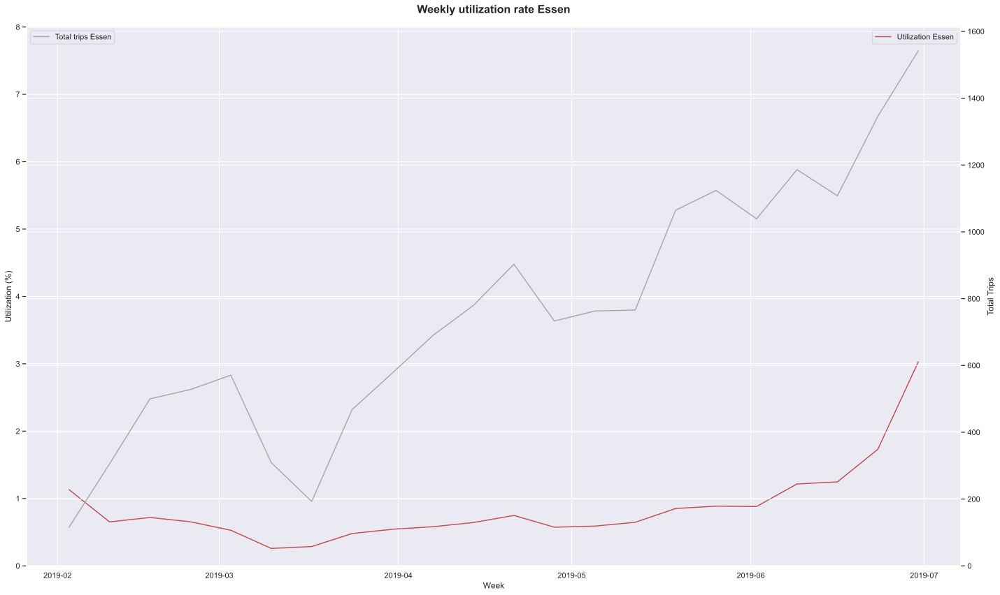

In [91]:
#weekly utilization rate Essen

fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot( daily_utilization_essen.groupby(pd.Grouper(key='timestamp', freq = 'W'))['capacity_utilization_rate'].mean(), label ='Utilization Essen', color='C3')

ax1.set_title('Weekly utilization rate Essen', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Week')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()


ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_essen.groupby(pd.Grouper(key='timestamp', freq = 'W'))['b_number'].count(), label='Total trips Essen', color = 'darkgrey')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)
ax2.legend(loc=2)

fig.tight_layout()

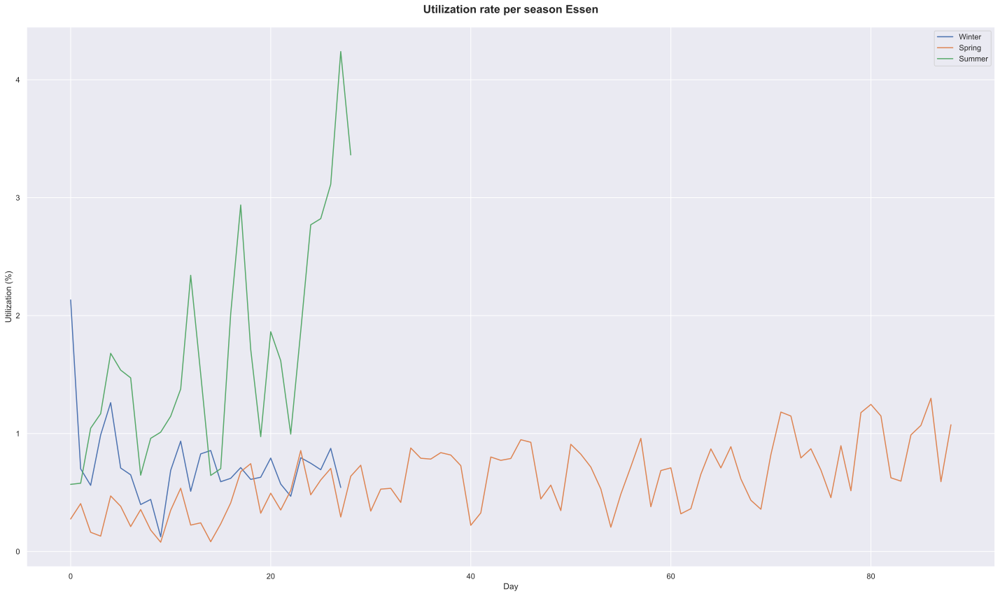

In [93]:
# Utilization rate per season in Essen

fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(daily_utilization_essen.loc[daily_utilization_essen['season'] == 0].reset_index()['capacity_utilization_rate'], label ='Winter')
ax1.plot(daily_utilization_essen.loc[daily_utilization_essen['season'] == 1].reset_index()['capacity_utilization_rate'], label ='Spring')
ax1.plot(daily_utilization_essen.loc[daily_utilization_essen['season'] == 2].reset_index()['capacity_utilization_rate'], label ='Summer')

ax1.set_title('Utilization rate per season Essen', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.legend()

fig.tight_layout()

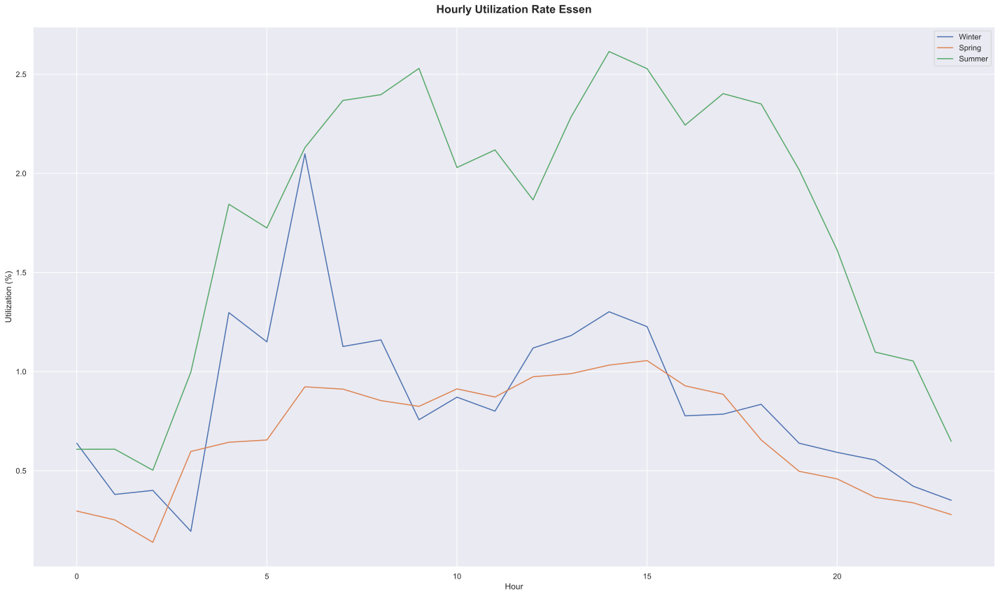

In [95]:
fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 0].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Winter')
ax1.plot(hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 1].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Spring')
ax1.plot(hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 2].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Summer')

ax1.set_title('Hourly Utilization Rate Essen', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Hour')
ax1.set_ylabel('Utilization (%)')
ax1.legend()

fig.tight_layout()

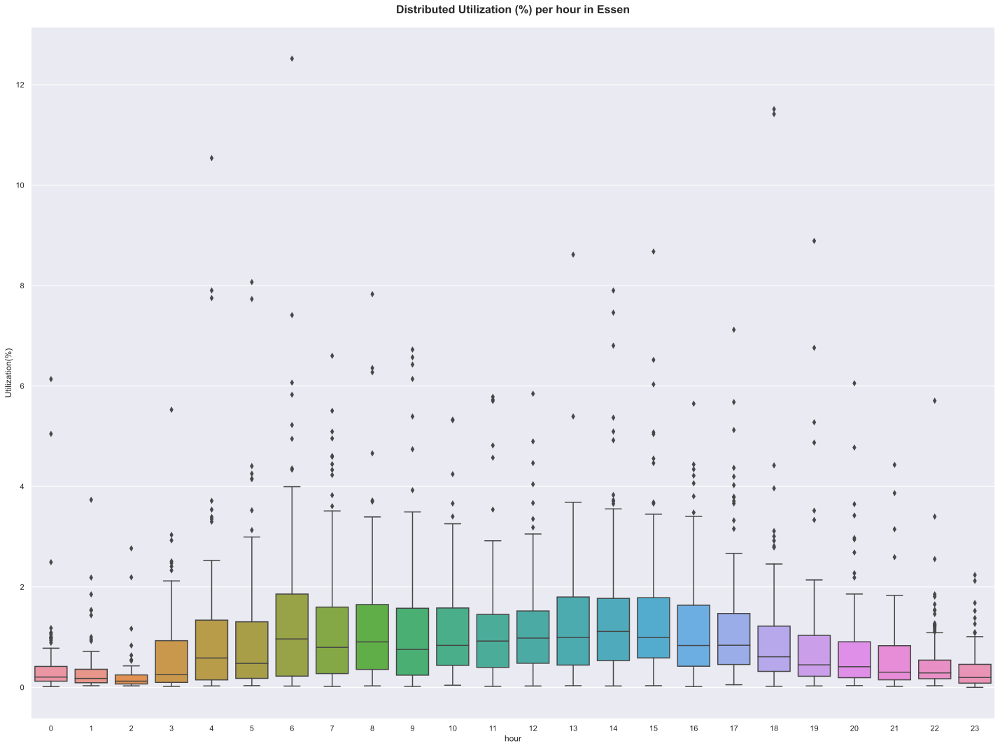

In [97]:
#mean hourly utilization in Essen

fig, ax1 = plt.subplots(figsize=(20,15))

sns.boxplot(ax = ax1, x="hour", y="capacity_utilization_rate",
                    data=hourly_utilization_essen)
sns.light_palette("Seagreen")

ax1.set_xlabel('hour')
ax1.set_ylabel('Utilization(%)')
ax1.set_title('Distributed Utilization (%) per hour in Essen', fontsize=16, fontweight="bold", pad=20)

fig.tight_layout()


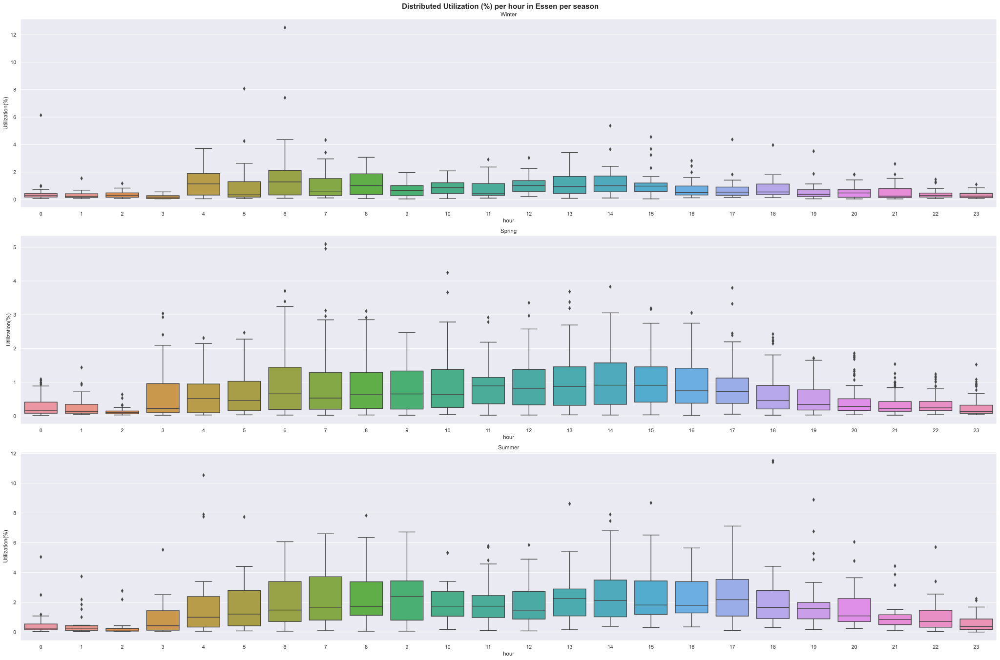

In [99]:
#mean hourly utilization in Bonn

fig, (ax1,ax2, ax3) = plt.subplots(3, figsize=(30,20))

sns.boxplot(ax = ax1, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 0])
fig.suptitle('Distributed Utilization (%) per hour in Essen per season', fontsize=16, fontweight="bold", va = 'center')


ax1.set_xlabel('hour')
ax1.set_ylabel('Utilization(%)')
ax1.set_title('Winter')

sns.boxplot(ax = ax2, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 1])


ax2.set_xlabel('hour')
ax2.set_ylabel('Utilization(%)')
ax2.set_title('Spring')

sns.boxplot(ax = ax3, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 2])

ax3.set_xlabel('hour')
ax3.set_ylabel('Utilization(%)')
ax3.set_title('Summer')

fig.tight_layout()

### 5: Intervention

In [101]:
'''#pickle down below
# Prepare the data

# Sort the entries by b_number and timestamp (Bonn)
df_bonn_idle = df_bonn.sort_values(["b_number", "timestamp"])
df_bonn_idle = df_bonn_idle.reset_index().drop(["index"], axis=1)

df_bonn_idle["idle_time"] = timedelta(days=0, hours=0, minutes=0, seconds=0)

for i in range(df_bonn_idle.shape[0] - 1):
    if df_bonn_idle["b_number"][i] == df_bonn_idle["b_number"][i+1]:
        df_bonn_idle["idle_time"][i+1] = df_bonn_idle["timestamp"][i+1] - (df_bonn_idle["timestamp"][i] + df_bonn_idle["trip_duration"][i])
    else:
        df_bonn_idle["idle_time"][i+1] = timedelta(days=0, hours=0, minutes=0, seconds=0)



# Removing trips which have no idle time because they are the first trip of this bike in the examined time period
df_bonn_no_idle = df_bonn_idle[df_bonn_idle["idle_time"] < timedelta(minutes=1)]
df_bonn_idle = df_bonn_idle[~df_bonn_idle.isin(df_bonn_no_idle).all(1)]

df_bonn_idle["idle_time_minutes"] = (df_bonn_idle["idle_time"].dt.days * 1440) + (df_bonn_idle["idle_time"].dt.seconds / 60)'''

'#pickle down below\n# Prepare the data\n\n# Sort the entries by b_number and timestamp (Bonn)\ndf_bonn_idle = df_bonn.sort_values(["b_number", "timestamp"])\ndf_bonn_idle = df_bonn_idle.reset_index().drop(["index"], axis=1)\n\ndf_bonn_idle["idle_time"] = timedelta(days=0, hours=0, minutes=0, seconds=0)\n\nfor i in range(df_bonn_idle.shape[0] - 1):\n    if df_bonn_idle["b_number"][i] == df_bonn_idle["b_number"][i+1]:\n        df_bonn_idle["idle_time"][i+1] = df_bonn_idle["timestamp"][i+1] - (df_bonn_idle["timestamp"][i] + df_bonn_idle["trip_duration"][i])\n    else:\n        df_bonn_idle["idle_time"][i+1] = timedelta(days=0, hours=0, minutes=0, seconds=0)\n\n\n\n# Removing trips which have no idle time because they are the first trip of this bike in the examined time period\ndf_bonn_no_idle = df_bonn_idle[df_bonn_idle["idle_time"] < timedelta(minutes=1)]\ndf_bonn_idle = df_bonn_idle[~df_bonn_idle.isin(df_bonn_no_idle).all(1)]\n\ndf_bonn_idle["idle_time_minutes"] = (df_bonn_idle["idle_t

In [103]:
'''df_essen_idle = df_essen.sort_values(["b_number", "timestamp"])
df_essen_idle = df_essen_idle.reset_index().drop(["index"], axis=1)

df_essen_idle["idle_time"] = timedelta(days=0, hours=0, minutes=0, seconds=0)

for i in range(df_essen_idle.shape[0] - 1):
    if df_essen_idle["b_number"][i] == df_essen_idle["b_number"][i+1]:
        df_essen_idle["idle_time"][i+1] = df_essen_idle["timestamp"][i+1] - (df_essen_idle["timestamp"][i] + df_essen_idle["trip_duration"][i])
    else:
        df_essen_idle["idle_time"][i+1] = timedelta(days=0, hours=0, minutes=0, seconds=0)

# Removing trips which have no idle time because they are the first trip of this bike in the examined time period
df_essen_no_idle = df_essen_idle[df_essen_idle["idle_time"] < timedelta(minutes=1)]
df_essen_idle = df_essen_idle[~df_essen_idle.isin(df_essen_no_idle).all(1)]

df_essen_idle["idle_time_minutes"] = (df_essen_idle["idle_time"].dt.days * 1440) + (df_essen_idle["idle_time"].dt.seconds / 60)'''

'df_essen_idle = df_essen.sort_values(["b_number", "timestamp"])\ndf_essen_idle = df_essen_idle.reset_index().drop(["index"], axis=1)\n\ndf_essen_idle["idle_time"] = timedelta(days=0, hours=0, minutes=0, seconds=0)\n\nfor i in range(df_essen_idle.shape[0] - 1):\n    if df_essen_idle["b_number"][i] == df_essen_idle["b_number"][i+1]:\n        df_essen_idle["idle_time"][i+1] = df_essen_idle["timestamp"][i+1] - (df_essen_idle["timestamp"][i] + df_essen_idle["trip_duration"][i])\n    else:\n        df_essen_idle["idle_time"][i+1] = timedelta(days=0, hours=0, minutes=0, seconds=0)\n\n# Removing trips which have no idle time because they are the first trip of this bike in the examined time period\ndf_essen_no_idle = df_essen_idle[df_essen_idle["idle_time"] < timedelta(minutes=1)]\ndf_essen_idle = df_essen_idle[~df_essen_idle.isin(df_essen_no_idle).all(1)]\n\ndf_essen_idle["idle_time_minutes"] = (df_essen_idle["idle_time"].dt.days * 1440) + (df_essen_idle["idle_time"].dt.seconds / 60)'

In [105]:
df_bonn_idle.head()

NameError: name 'df_bonn_idle' is not defined

In [107]:
'''df_bonn_idle = df_bonn_idle.sort_values(["b_number", "timestamp"])
df_bonn_idle = df_bonn_idle.reset_index().drop(["index"], axis=1)

df_bonn_idle["distance_switched_position"] = 0 
df_bonn_idle["Last_ride"] = timedelta(days=0, hours=0, minutes=0, seconds=0)
df_bonn_idle['Last_ride_dest'] = df_bonn['dest']

for i in range(df_bonn_idle.shape[0] - 1):
    if df_bonn_idle["b_number"][i] == df_bonn_idle["b_number"][i+1]:
        if df_bonn_idle["dest"][i][0] == df_bonn_idle["orig"][i+1][0] and df_bonn_idle["dest"][i][1] == df_bonn_idle["orig"][i+1][1]: 
            df_bonn_idle["distance_switched_position"][i+1] = 0
            df_bonn_idle['Last_ride_dest'][i+1] = 0
        else:
            df_bonn_idle["distance_switched_position"][i+1] = haversine(df_bonn_idle["dest"][i], df_bonn_idle["orig"][i+1], unit=Unit.METERS)
            df_bonn_idle["Last_ride"][i+1] = df_bonn_idle['idle_time'][i]
            df_bonn_idle['Last_ride_dest'][i+1] = df_bonn_idle['dest'][i]
    else:
        df_bonn_idle["distance_switched_position"][i+1] = 0
        df_bonn_idle['Last_ride_dest'][i+1] = 0'''

'df_bonn_idle = df_bonn_idle.sort_values(["b_number", "timestamp"])\ndf_bonn_idle = df_bonn_idle.reset_index().drop(["index"], axis=1)\n\ndf_bonn_idle["distance_switched_position"] = 0 \ndf_bonn_idle["Last_ride"] = timedelta(days=0, hours=0, minutes=0, seconds=0)\ndf_bonn_idle[\'Last_ride_dest\'] = df_bonn[\'dest\']\n\nfor i in range(df_bonn_idle.shape[0] - 1):\n    if df_bonn_idle["b_number"][i] == df_bonn_idle["b_number"][i+1]:\n        if df_bonn_idle["dest"][i][0] == df_bonn_idle["orig"][i+1][0] and df_bonn_idle["dest"][i][1] == df_bonn_idle["orig"][i+1][1]: \n            df_bonn_idle["distance_switched_position"][i+1] = 0\n            df_bonn_idle[\'Last_ride_dest\'][i+1] = 0\n        else:\n            df_bonn_idle["distance_switched_position"][i+1] = haversine(df_bonn_idle["dest"][i], df_bonn_idle["orig"][i+1], unit=Unit.METERS)\n            df_bonn_idle["Last_ride"][i+1] = df_bonn_idle[\'idle_time\'][i]\n            df_bonn_idle[\'Last_ride_dest\'][i+1] = df_bonn_idle[\'dest\']

In [108]:
'''df_essen_idle = df_essen_idle.sort_values(["b_number", "timestamp"])
df_essen_idle = df_essen_idle.reset_index().drop(["index"], axis=1)

df_essen_idle["distance_switched_position"] = 0 
df_essen_idle["Last_ride"] = timedelta(days=0, hours=0, minutes=0, seconds=0)
df_essen_idle['Last_ride_dest'] = df_essen['dest']

for i in range(df_essen_idle.shape[0] - 1):
    if df_essen_idle["b_number"][i] == df_essen_idle["b_number"][i+1]:
        if df_essen_idle["dest"][i][0] == df_essen_idle["orig"][i+1][0] and df_essen_idle["dest"][i][1] == df_essen_idle["orig"][i+1][1]: 
            df_essen_idle["distance_switched_position"][i+1] = 0
            df_essen_idle['Last_ride_dest'][i+1] = 0
        else:
            df_essen_idle["distance_switched_position"][i+1] = haversine(df_essen_idle["dest"][i], df_essen_idle["orig"][i+1], unit=Unit.METERS)
            df_essen_idle["Last_ride"][i+1] = df_essen_idle['idle_time'][i]
            df_essen_idle['Last_ride_dest'][i+1] = df_essen_idle['dest'][i]
    else:
        df_essen_idle["distance_switched_position"][i+1] = 0
        df_essen_idle['Last_ride_dest'][i+1] = 0'''

'df_essen_idle = df_essen_idle.sort_values(["b_number", "timestamp"])\ndf_essen_idle = df_essen_idle.reset_index().drop(["index"], axis=1)\n\ndf_essen_idle["distance_switched_position"] = 0 \ndf_essen_idle["Last_ride"] = timedelta(days=0, hours=0, minutes=0, seconds=0)\ndf_essen_idle[\'Last_ride_dest\'] = df_essen[\'dest\']\n\nfor i in range(df_essen_idle.shape[0] - 1):\n    if df_essen_idle["b_number"][i] == df_essen_idle["b_number"][i+1]:\n        if df_essen_idle["dest"][i][0] == df_essen_idle["orig"][i+1][0] and df_essen_idle["dest"][i][1] == df_essen_idle["orig"][i+1][1]: \n            df_essen_idle["distance_switched_position"][i+1] = 0\n            df_essen_idle[\'Last_ride_dest\'][i+1] = 0\n        else:\n            df_essen_idle["distance_switched_position"][i+1] = haversine(df_essen_idle["dest"][i], df_essen_idle["orig"][i+1], unit=Unit.METERS)\n            df_essen_idle["Last_ride"][i+1] = df_essen_idle[\'idle_time\'][i]\n            df_essen_idle[\'Last_ride_dest\'][i+1] =

In [109]:
df_bonn_idle.head()

NameError: name 'df_bonn_idle' is not defined

In [90]:
#distance between start and end point

'''df_bonn_idle["distance (km)"] = df_bonn.apply(lambda row: haversine(row["orig"], row["dest"]), axis=1)
df_essen_idle["distance (km)"] = df_essen.apply(lambda row: haversine(row["orig"], row["dest"]), axis=1)

#distance between city center and end point

df_bonn_idle["distance_city_center"] = df_bonn.apply(lambda row: haversine(bonn_center, row["dest"]), axis=1)
df_essen_idle["distance_city_center"] = df_essen.apply(lambda row: haversine(essen_center, row["dest"]), axis=1)'''

In [91]:
'''df_bonn_idle.to_pickle("data/df_bonn_idle.pickle")
df_essen_idle.to_pickle("data/df_essen_idle.pickle")'''

In [92]:
df_bonn_idle = pd.read_pickle("data/df_bonn_idle.pickle")
df_essen_idle = pd.read_pickle("data/df_essen_idle.pickle")

In [93]:
df_essen_idle.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15915 entries, 0 to 15914
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype          
---  ------                      --------------  -----          
 0   day                         15915 non-null  object         
 1   time                        15915 non-null  object         
 2   b_number                    15915 non-null  int64          
 3   city                        15915 non-null  object         
 4   trip_duration               15915 non-null  timedelta64[ns]
 5   timestamp                   15915 non-null  datetime64[ns] 
 6   weekday                     15915 non-null  int64          
 7   hour                        15915 non-null  int64          
 8   season                      15915 non-null  int64          
 9   orig                        15915 non-null  object         
 10  dest                        15915 non-null  object         
 11  Rides                       15915 non-nul

In [94]:
df_bonn_intervention = df_bonn_idle.loc[df_bonn_idle['distance_switched_position']> 99].reset_index()
df_essen_intervention = df_essen_idle.loc[df_essen_idle['distance_switched_position']> 99].reset_index()
 

In [95]:
# definition of a intervention of nextbike
# interveniton = human interaction = labor costs
# Intervention 1 = bike trip start in a diffrent position than the last trip ended 
# Intervention 2 = idle time > X Minutes 

In [96]:
# show position changes 
def interventions_zone_map(location, df_interventions):
        #First draw a map like zone_map() does
         # Generate a map - centered on the given location
        if (location == bonn_center).all():
            location = location-np.array([-0.1, 0.3]) # shift by [-0.1, 0.3] to make it look better (more centered)
        elif (location == essen_center).all():
            location = location-np.array([0, 0]) # shift by [0.1, 0] to make it look better (more centered)

        interventions_zone_map = folium.Map(
            location = location,
            tiles = "OpenStreetMap",
            zoom_start = 10)
    
        # Now outliers have to be added to the map
        # The outliers are stored in df_outliers
        for index, row in df_interventions.iterrows():
            
            # Save startpoint and endpoint
            startpoint = tuple(row["Last_ride_dest"])
            #endpoint = tuple(row["orig"])
            
            # Draw the lines between startpoints and endpoints
            #folium.PolyLine(
            #locations = [startpoint, endpoint],
            #color = "purple",
            #weight = 2,
            #opacity = 0.5
            #).add_to(interventions_zone_map)
            
            #Draw Cricles for startpoints and endpoints
            #Green circles = startpoints
            folium.CircleMarker(
            location = startpoint,
            radius = 4,
            color = "green").add_to(interventions_zone_map)
            # Red circles = endpoints
            #folium.CircleMarker(
            #location = endpoint,
            #radius = 4,
            #color = "crimson").add_to(interventions_zone_map) 
        
        return interventions_zone_map

In [97]:
interventions_zone_map(bonn_center, df_bonn_intervention)

In [98]:
interventions_zone_map(essen_center, df_essen_intervention)

In [99]:
#Interventions in diffrent times overall

total_interventions= pd.DataFrame(data = {'city': ['Bonn', 'Essen' ], 'total': [df_bonn_intervention['timestamp'].count(), df_essen_intervention['timestamp'].count()], 'per_1000_trips': [(df_bonn_intervention['timestamp'].count()/df_bonn['timestamp'].count()) * 1000,(df_essen_intervention['timestamp'].count()/df_essen['timestamp'].count()) * 1000]})

total_interventions.head()




,city,total,per_1000_trips
0,Bonn,23952,72.733677
1,Essen,3515,211.581292


Text(0, 0.5, 'Total Interventions')

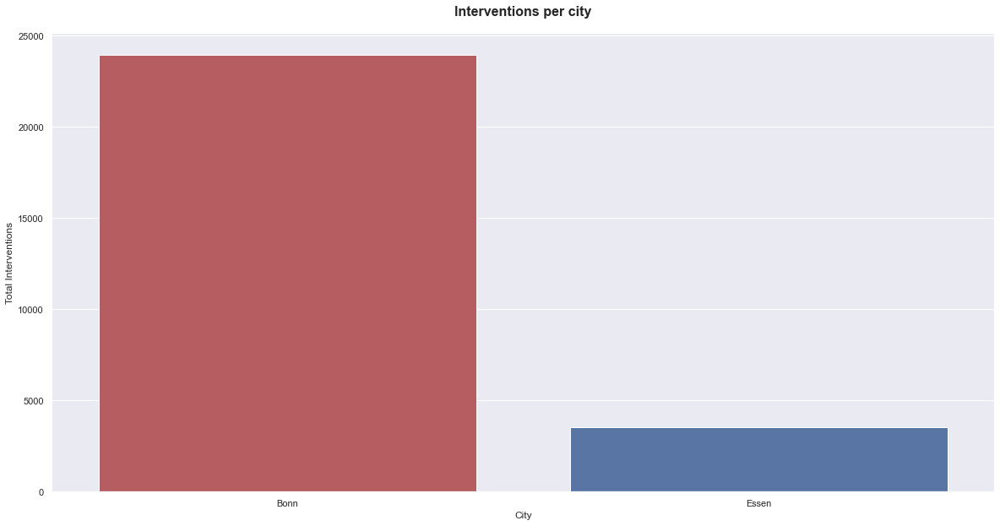

In [101]:
#compare total Interventions per City

#prepare data

fig, ax = plt.subplots(figsize=(20,10))

clrs = ['C3', 'C0' ]

ax = sns.barplot(x = 'city', y = 'total', data = total_interventions, palette= clrs)

ax.set_title('Interventions per city', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('City')
ax.set_ylabel('Total Interventions')


Text(0, 0.5, 'Interventions per 1000 trips')

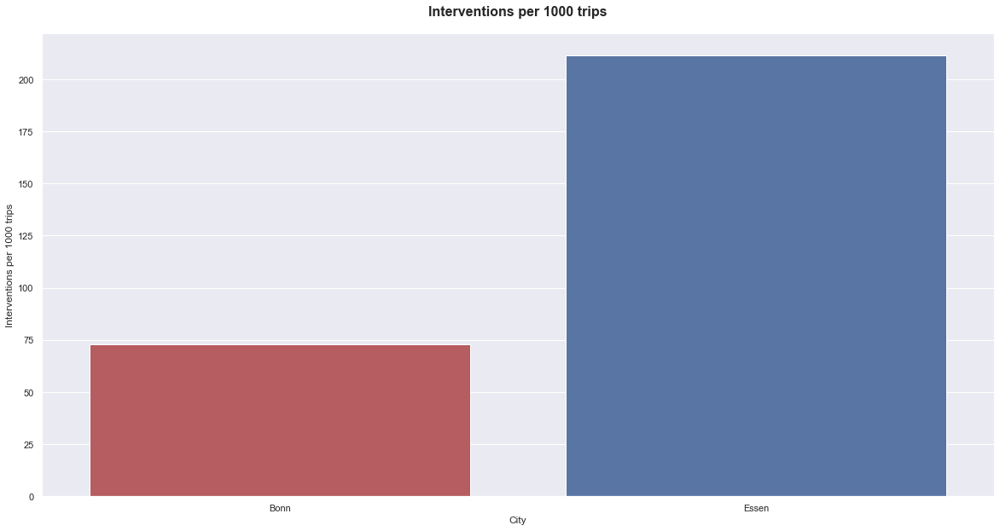

In [102]:
# compare Interventions per trip per 1000 trips

fig, ax = plt.subplots(figsize=(20,10))

clrs = ['C3', 'C0']

ax = sns.barplot(x = 'city', y = 'per_1000_trips', data = total_interventions, palette= clrs)

ax.set_title('Interventions per 1000 trips', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('City')
ax.set_ylabel('Interventions per 1000 trips')

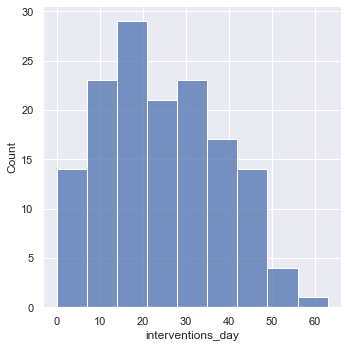

In [103]:
#Interventions per day in Essen



#fig, ax = plt.subplots(figsize=(20,10))

sns.displot(df_essen_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day'), x='interventions_day', color = "C0")

#ax.set_title('Interventions per city per 1000 trips', fontsize=16, fontweight="bold", pad=20)
#ax.set_xlabel('City')
#ax.set_ylabel('INterventions per 1000 trips')


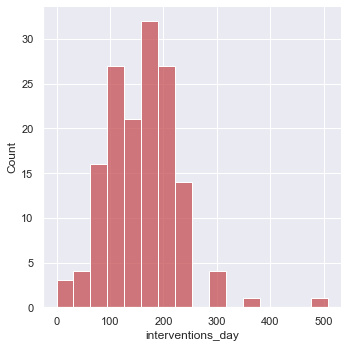

In [104]:
#Interventions per day in Bonn


sns.displot(df_bonn_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day'), x='interventions_day', color = "C3")


(0.0, 66.15)

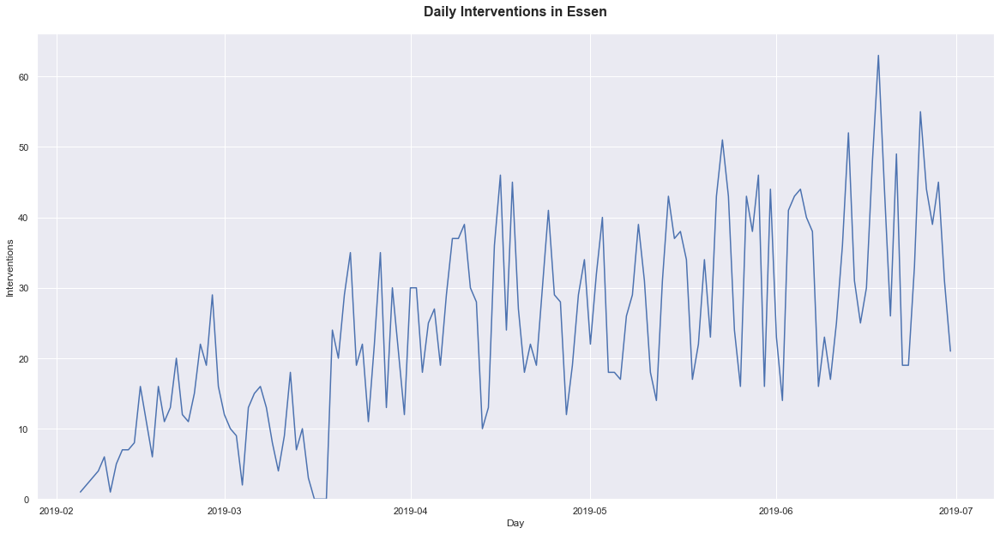

In [105]:
#daily interventionsin essen 
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = df_essen_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day'), x='timestamp', y= 'interventions_day',   color = "C0")

ax.set_title('Daily Interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Day')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

(0.0, 532.35)

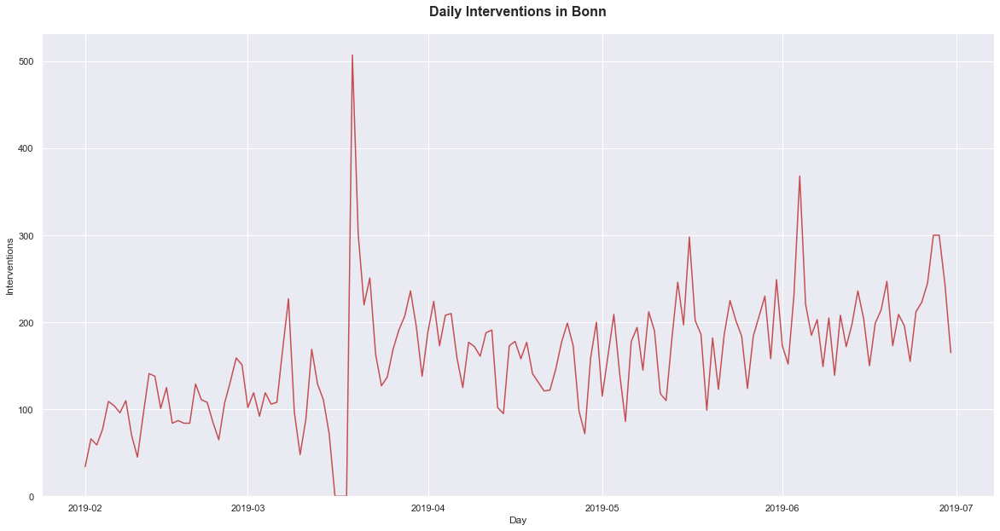

In [106]:
#daily interventionsin Bonn 
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = df_bonn_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day'), x='timestamp', y= 'interventions_day',   color = "C3")

ax.set_title('Daily Interventions in Bonn', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Day')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

Text(0, 0.5, 'Interventions')

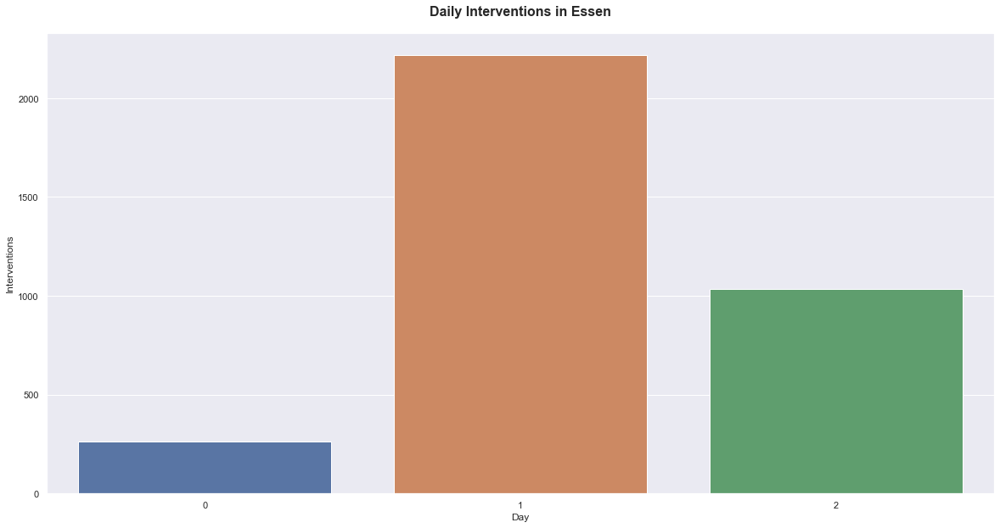

In [107]:
#daily interventionsin essen 
fig, ax = plt.subplots(figsize=(20,10))

'''ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 0]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day').drop('timestamp', axis=1) , label = 'Winter', color='C0')
ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 1]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day').drop('timestamp', axis=1), label = 'Spring', color='C1')
ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 2]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day').drop('timestamp', axis=1), label = 'Summer', color='C2')'''
ax = sns.barplot(data = df_essen_intervention.groupby(['day', 'season'])['time'].count().reset_index().drop('day', axis =1).groupby('season')['time'].sum().reset_index(name='total_interventions'), x= 'season', y='total_interventions')


ax.set_title('Daily Interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Day')
ax.set_ylabel('Interventions')


In [108]:
df_essen_intervention.groupby(['day', 'season'])['time'].count().reset_index().drop('day', axis =1)

,season,time
0,0,1
1,0,2
2,0,3
3,0,4
4,0,6
...,...,...
138,2,44
139,2,39
140,2,45
141,2,31


(0.0, 280.55)

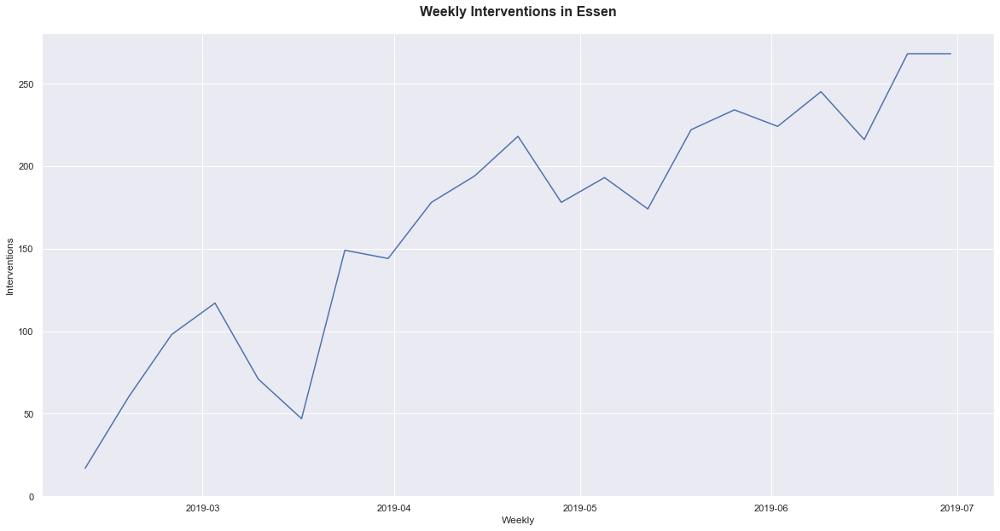

In [109]:
#weekly interventionsin essen 
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = df_essen_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'), x='timestamp', y= 'interventions_day',   color = "C0")

ax.set_title('Weekly Interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Weekly')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

(0.0, 1764.45)

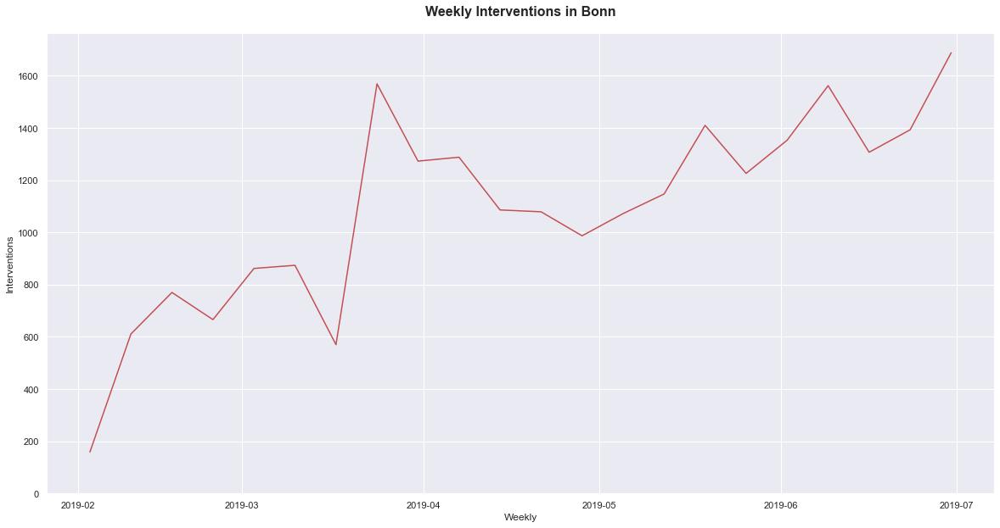

In [110]:
#weekly interventionsin bonn 
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = df_bonn_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'), x='timestamp', y= 'interventions_day',   color = "C3")

ax.set_title('Weekly Interventions in Bonn', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Weekly')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

(0.0, 0.05500000000000001)

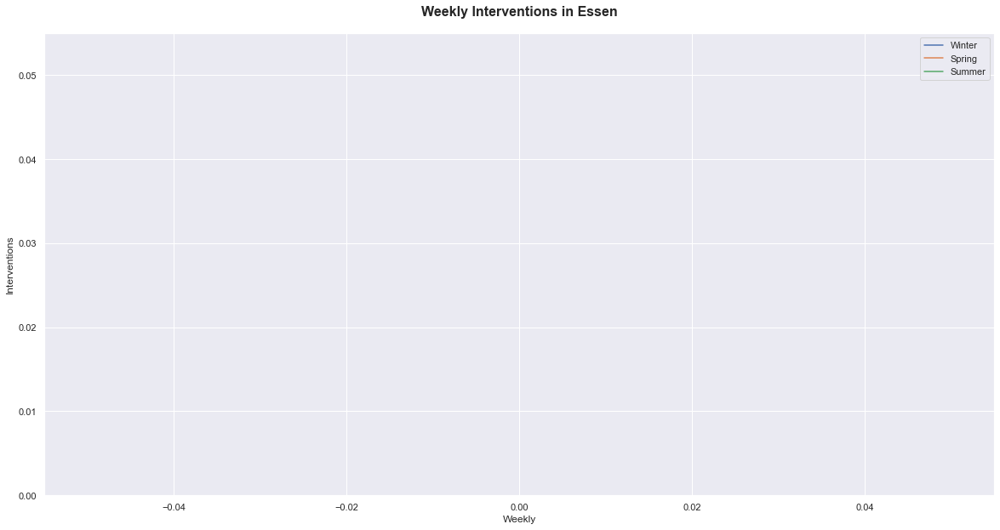

In [111]:
#weekly interventionsin essen per season
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 0]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'), y= 'interventions_day', label = 'Winter')
ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 1]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'),  y= 'interventions_day', label = 'Spring')
ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 2]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'),  y= 'interventions_day', label = 'Summer')

ax.set_title('Weekly Interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Weekly')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

Text(0, 0.5, 'Interventions (mean)')

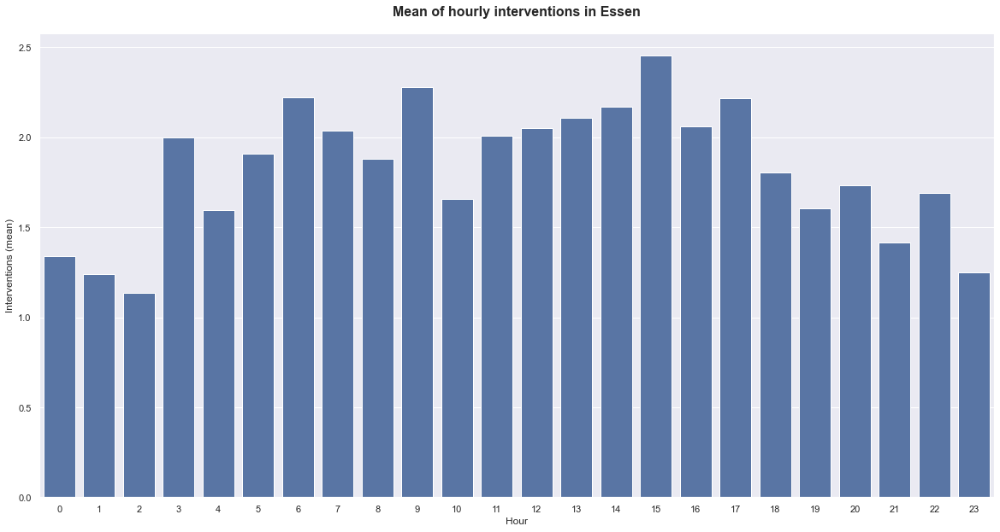

In [112]:

fig, ax = plt.subplots(figsize=(20,10))


ax = sns.barplot(x = 'hour', y = 'hourly_mean', data = df_essen_intervention.groupby(['day', 'hour'])['time'].count().reset_index().groupby('hour')['time'].mean().reset_index(name='hourly_mean'), color = 'C0')

ax.set_title('Mean of hourly interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Hour')
ax.set_ylabel('Interventions (mean)')

Text(0, 0.5, 'Interventions (mean)')

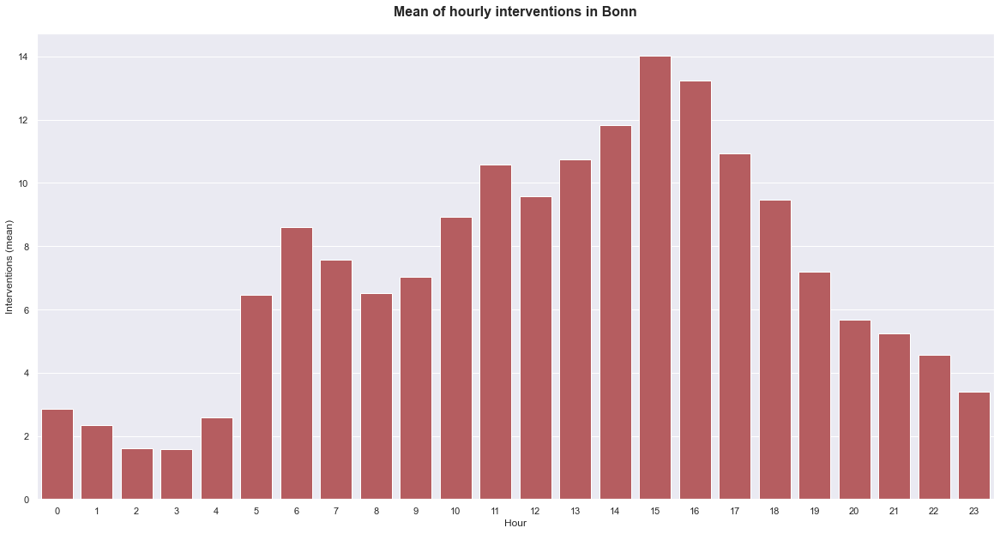

In [113]:
fig, ax = plt.subplots(figsize=(20,10))


ax = sns.barplot(x = 'hour', y = 'hourly_mean', data = df_bonn_intervention.groupby(['day', 'hour'])['time'].count().reset_index().groupby('hour')['time'].mean().reset_index(name='hourly_mean'), color = 'C3')

ax.set_title('Mean of hourly interventions in Bonn', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Hour')
ax.set_ylabel('Interventions (mean)')

Text(0.5, 0.98, 'Mean of hourly interventions per Season')

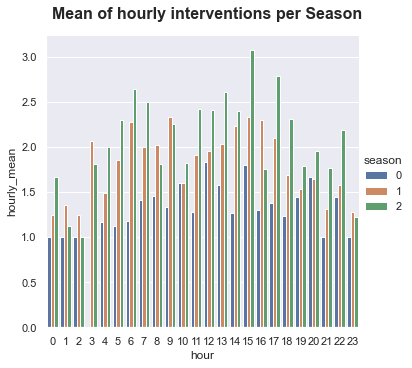

In [114]:
#fig, ax = plt.subplots(figsize=(20,10))

ax = sns.catplot(x = 'hour', y = 'hourly_mean', hue= 'season', data = df_essen_intervention.groupby(['season', 'day', 'hour'])['time'].count().reset_index().groupby(['season','hour'])['time'].mean().reset_index(name='hourly_mean'), kind="bar")

ax.fig.subplots_adjust(top=0.9)
ax.fig.suptitle('Mean of hourly interventions per Season', fontsize=16, fontweight="bold")


#ax.set_title('Mean of hourly interventions in Essen', fontsize=16, fontweight="bold", pad=20)
#ax.set_xlabel('Hour')
#ax.set_ylabel('Interventions (mean)')

Text(0.5, 0.98, 'Mean of hourly interventions per Season')

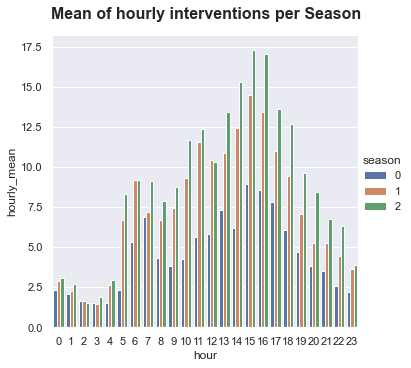

In [115]:
#fig, ax = plt.subplots(figsize=(20,10))

ax = sns.catplot(x = 'hour', y = 'hourly_mean', hue= 'season', data = df_bonn_intervention.groupby(['season', 'day', 'hour'])['time'].count().reset_index().groupby(['season','hour'])['time'].mean().reset_index(name='hourly_mean'), kind="bar")

ax.fig.subplots_adjust(top=0.9)
ax.fig.suptitle('Mean of hourly interventions per Season', fontsize=16, fontweight="bold")


#ax.set_title('Mean of hourly interventions in Bonn', fontsize=16, fontweight="bold", pad=20)
#ax.set_xlabel('Hour')
#ax.set_ylabel('Interventions (mean)')

In [116]:
'''#idle time + rate
daily_utilization_bonn['idle_time']  = df_bonn_idle.groupby(pd.Grouper(key='timestamp', freq='D'))['idle_time'].agg('sum').dropna().reset_index()['idle_time']
daily_utilization_bonn['idle_time'] = (daily_utilization_bonn['idle_time'].dt.days * 1440) + (daily_utilization_bonn['idle_time'].dt.seconds / 60)
daily_utilization_bonn['idle_time_rate'] = pd.to_numeric(100 * daily_utilization_bonn['idle_time'] / daily_utilization_bonn['max_capacity'])'''

"#idle time + rate\ndaily_utilization_bonn['idle_time']  = df_bonn_idle.groupby(pd.Grouper(key='timestamp', freq='D'))['idle_time'].agg('sum').dropna().reset_index()['idle_time']\ndaily_utilization_bonn['idle_time'] = (daily_utilization_bonn['idle_time'].dt.days * 1440) + (daily_utilization_bonn['idle_time'].dt.seconds / 60)\ndaily_utilization_bonn['idle_time_rate'] = pd.to_numeric(100 * daily_utilization_bonn['idle_time'] / daily_utilization_bonn['max_capacity'])"

In [117]:
'''#idle time + rate
daily_utilization_essen['idle_time']  = df_essen_idle.groupby(pd.Grouper(key='timestamp', freq='D'))['idle_time'].agg('sum').dropna().reset_index()['idle_time']
daily_utilization_essen['idle_time'] = (daily_utilization_essen['idle_time'].dt.days * 1440) + (daily_utilization_essen['idle_time'].dt.seconds / 60)
daily_utilization_essen['idle_time_rate'] = pd.to_numeric(100 * daily_utilization_essen['idle_time'] / daily_utilization_essen['max_capacity'])'''

"#idle time + rate\ndaily_utilization_essen['idle_time']  = df_essen_idle.groupby(pd.Grouper(key='timestamp', freq='D'))['idle_time'].agg('sum').dropna().reset_index()['idle_time']\ndaily_utilization_essen['idle_time'] = (daily_utilization_essen['idle_time'].dt.days * 1440) + (daily_utilization_essen['idle_time'].dt.seconds / 60)\ndaily_utilization_essen['idle_time_rate'] = pd.to_numeric(100 * daily_utilization_essen['idle_time'] / daily_utilization_essen['max_capacity'])"